[![Open in Colab](https://colab.research.google.com/assets/colab-badge.svg)](https://colab.research.google.com/github/MokryYezhik/studying-CNN/blob/master/%5Bhw%5Dsemantic_segmentation_final.ipynb)

<p style="align: center;"><img align=center src="https://s8.hostingkartinok.com/uploads/images/2018/08/308b49fcfbc619d629fe4604bceb67ac.jpg" width=500 height=450/></p>
<h3 style="text-align: center;"><b>Школа глубокого обучения ФПМИ МФТИ</b></h3>

<h3 style="text-align: center;"><b>Домашнее задание. Сегментация изображений</b></h3>


В этом задании вам предстоит решить задачу сегментации медицинских снимков. Часть кода с загрузкой данных написана за вас. Всю содержательную сторону вопроса вам нужно заполнить самостоятельно. Задание оценивается из 15 баллов. 

Обратите внимание, что отчёт по заданию стоит целых 6 баллов. Он вынесен в отдельный пункт в конце тетради. Это сделано для того, чтобы тетрадь была оформлена как законченный документ о проведении экспериментов. Неотъемлемой составляющей отчёта является ответ на следующие вопросы:

* Что было сделано? Что получилось реализовать, что не получилось?
* Какие результаты ожидалось получить?
* Какие результаты были достигнуты?
* Чем результаты различных подходов отличались друг от друга и от бейзлайна (если таковой присутствует)?




---


1. Для начала мы скачаем датасет: [ADDI project](https://www.fc.up.pt/addi/ph2%20database.html).

<table><tr><td>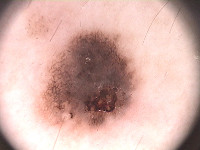</td><td>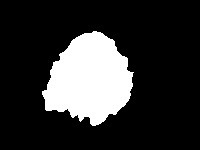</td></tr></table>

2. Разархивируем .rar файл.
3. Обратите внимание, что папка  `PH2 Dataset images` должна лежать там же где и ipynb notebook.

Это фотографии двух типов **поражений кожи:** меланома и родинки.
В данном задании мы не будем заниматься их классификацией, а будем **сегментировать** их.

In [ ]:
!pip install gdown

In [ ]:
import gdown

url = 'https://drive.google.com/uc?id=1VtEDXKLJSe0-x3RnQvlvZZv9bqKMte0h'
output = 'PH2Dataset.rar'
gdown.download(url, output, quiet=False)

Downloading...
From: https://drive.google.com/uc?id=1VtEDXKLJSe0-x3RnQvlvZZv9bqKMte0h
To: /content/PH2Dataset.rar
100%|██████████| 116M/116M [00:03<00:00, 37.0MB/s]


'PH2Dataset.rar'

In [ ]:
get_ipython().system_raw("unrar x ./PH2Dataset.rar")

In [ ]:
from google.colab import drive
drive.mount('/content/gdrive/', force_remount=True)

Mounted at /content/gdrive/


Стуктура датасета у нас следующая:

    IMD_002/
        IMD002_Dermoscopic_Image/
            IMD002.bmp
        IMD002_lesion/
            IMD002_lesion.bmp
        IMD002_roi/
            ...
    IMD_003/
        ...
        ...

 Здесь `X.bmp` — изображение, которое нужно сегментировать, `X_lesion.bmp` — результат сегментации.

Для загрузки датасета можно использовать skimage: [`skimage.io.imread()`](https://scikit-image.org/docs/dev/api/skimage.io.html)

In [ ]:
images = []
lesions = []
from skimage.io import imread
import os
root = 'PH2Dataset'

for root, dirs, files in os.walk(os.path.join(root, 'PH2 Dataset images')):
    if root.endswith('_Dermoscopic_Image'):
        images.append(imread(os.path.join(root, files[0])))
    if root.endswith('_lesion'):
        lesions.append(imread(os.path.join(root, files[0])))

Изображения имеют разные размеры. Давайте изменим их размер на $256\times256 $ пикселей. Для изменения размера изображений можно использовать [`skimage.transform.resize()`](https://scikit-image.org/docs/dev/api/skimage.transform.html#skimage.transform.resize).
Эта функция также автоматически нормализует изображения в диапазоне $[0,1]$.


In [ ]:
from skimage.transform import resize
size = (256, 256)
X = [resize(x, size, mode='constant', anti_aliasing=True,) for x in images]
Y = [resize(y, size, mode='constant', anti_aliasing=False) > 0.5 for y in lesions]

In [ ]:
import numpy as np
X = np.array(X, np.float32)
Y = np.array(Y, np.float32)
print(f'Loaded {len(X)} images')

Loaded 200 images


In [ ]:
len(lesions)

200

In [ ]:
X.shape, X[0].shape, Y.shape, Y[0].shape

((200, 256, 256, 3), (256, 256, 3), (200, 256, 256), (256, 256))

Чтобы убедиться, что все корректно, мы нарисуем несколько изображений

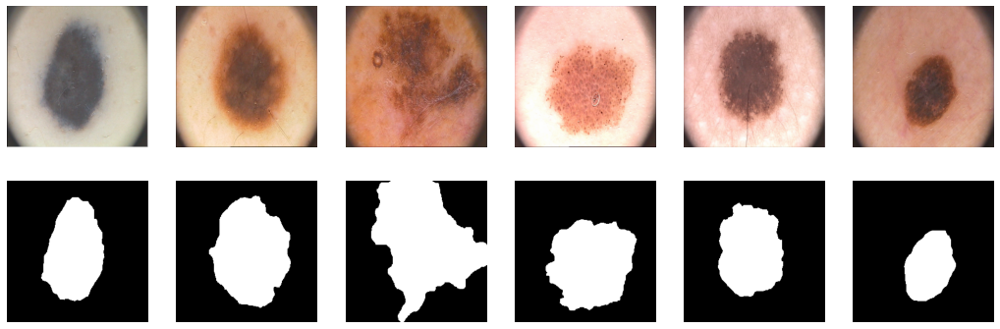

In [ ]:
import matplotlib.pyplot as plt
from IPython.display import clear_output

plt.figure(figsize=(18, 6))
for i in range(6):
    plt.subplot(2, 6, i+1)
    plt.axis("off")
    plt.imshow(X[i])

    plt.subplot(2, 6, i+7)
    plt.axis("off")
    plt.imshow(Y[i], cmap='gray')
plt.show();

Разделим наши 200 картинок на 100/50/50
 для обучения, валидации и теста соответственно

In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F
from torchvision import models
import torch.optim as optim
from time import time
import json
import random

from matplotlib import rcParams
rcParams['figure.figsize'] = (15,4)

import warnings
warnings.filterwarnings("ignore")

In [ ]:
def set_seed(seed):
    torch.manual_seed(seed)
    torch.cuda.manual_seed_all(seed)
    torch.backends.cudnn.deterministic = True
    torch.backends.cudnn.benchmark = False
    np.random.seed(seed)
    random.seed(seed)
    #os.environ['PYTHONHASHSEED'] = str(seed)

set_seed(42)

In [ ]:
ix = np.random.choice(len(X), len(X), False, )
tr, val, ts = np.split(ix, [100, 150])

In [ ]:
print(len(tr), len(val), len(ts))

100 50 50


#### PyTorch DataLoader

In [ ]:
from torch.utils.data import DataLoader
batch_size = 25
data_tr = DataLoader(list(zip(np.rollaxis(X[tr], 3, 1), Y[tr, np.newaxis])), 
                     batch_size=batch_size, shuffle=True)
data_val = DataLoader(list(zip(np.rollaxis(X[val], 3, 1), Y[val, np.newaxis])),
                      batch_size=batch_size, shuffle=False)
data_ts = DataLoader(list(zip(np.rollaxis(X[ts], 3, 1), Y[ts, np.newaxis])),
                     batch_size=batch_size, shuffle=False)

In [ ]:
len(data_tr.dataset), len(data_val.dataset), len(data_ts.dataset)

(100, 50, 50)

In [ ]:
DEVICE = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(f'DEVICE: {DEVICE}')

DEVICE: cpu


In [ ]:
print(f'Image shape: {data_tr.dataset[0][0].shape}')
print(f'Mask shape: {data_tr.dataset[0][1].shape}')

Image shape: (3, 256, 256)
Mask shape: (1, 256, 256)


# Реализация различных архитектур:
Ваше задание будет состоять в том, чтобы написать несколько нейросетевых архитектур для решения задачи семантической сегментации. Сравнить их по качеству на тесте и испробовать различные лосс функции для них.

-----------------------------------------------------------------------------------------

# SegNet [2 балла]

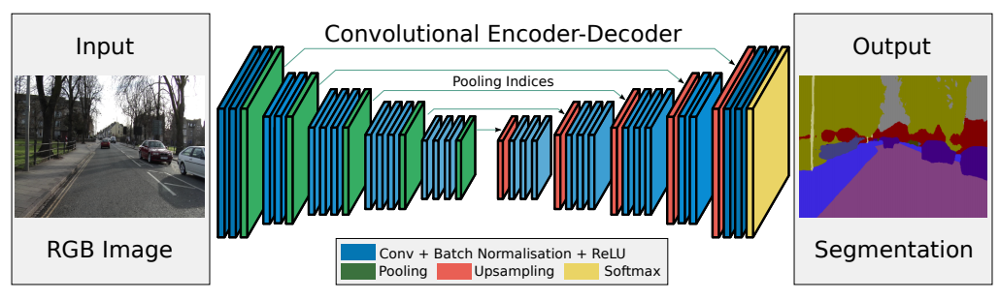

* Badrinarayanan, V., Kendall, A., & Cipolla, R. (2015). [SegNet: A deep convolutional
encoder-decoder architecture for image segmentation](https://arxiv.org/pdf/1511.00561.pdf)

Внимательно посмотрите из чего состоит модель и для чего выбраны те или иные блоки.

In [ ]:
def conv2(in_c: int,  out_c: int, type: str = 'encoder'):
    if type == 'encoder':
        block = nn.Sequential(
                nn.Conv2d(in_c, out_c, kernel_size=3, padding=1),
                nn.BatchNorm2d(out_c, eps=1e-05, momentum=0.1),
                nn.ReLU(inplace=True),
                nn.Conv2d(out_c, out_c, kernel_size=3, padding=1),
                nn.BatchNorm2d(out_c, eps=1e-05, momentum=0.1),
                nn.ReLU(inplace=True),
          )
    elif type == 'decoder':
        block = nn.Sequential(
                nn.Conv2d(in_c, in_c, kernel_size=3, padding=1),
                nn.BatchNorm2d(in_c, eps=1e-05, momentum=0.1),
                nn.ReLU(inplace=True),
                nn.Conv2d(in_c, out_c, kernel_size=3, padding=1),
                nn.BatchNorm2d(out_c, eps=1e-05, momentum=0.1),
                nn.ReLU(inplace=True),
          )
    else:
        print("Type should be either 'encoder' or 'decoder'")
    return block

def conv3(in_c: int,  out_c: int, type: str = 'encoder'):
    if type == 'encoder':
        block = nn.Sequential(
                nn.Conv2d(in_c, out_c, kernel_size=3, padding=1),
                nn.BatchNorm2d(out_c, eps=1e-05, momentum=0.1),
                nn.ReLU(inplace=True),
                nn.Conv2d(out_c, out_c, kernel_size=3, padding=1),
                nn.BatchNorm2d(out_c, eps=1e-05, momentum=0.1),
                nn.ReLU(inplace=True),
                nn.Conv2d(out_c, out_c, kernel_size=3, padding=1),
                nn.BatchNorm2d(out_c, eps=1e-05, momentum=0.1),
                nn.ReLU(inplace=True),
          )
    elif type == 'decoder':
        block = nn.Sequential(
                nn.Conv2d(in_c, in_c, kernel_size=3, padding=1),
                nn.BatchNorm2d(in_c, eps=1e-05, momentum=0.1),
                nn.ReLU(inplace=True),
                nn.Conv2d(in_c, in_c, kernel_size=3, padding=1),
                nn.BatchNorm2d(in_c, eps=1e-05, momentum=0.1),
                nn.ReLU(inplace=True),
                nn.Conv2d(in_c, out_c, kernel_size=3, padding=1),
                nn.BatchNorm2d(out_c, eps=1e-05, momentum=0.1),
                nn.ReLU(inplace=True),
          )
    else:
        print("Type should be either 'encoder' or 'decoder'")
    return block

In [ ]:
class SegNet(nn.Module):
    def __init__(self, in_channels: int = 3, out_cnahhels: int = 1):
        super().__init__()

        self.e_conv1 = conv2(in_channels,  64, type='encoder') # 256 -> 128
        self.e_conv2 = conv2(64,  128, type='encoder') # 128 -> 64
        self.e_conv3 = conv3(128,  256, type='encoder') # 64 -> 32
        self.e_conv4 = conv3(256,  512,  type='encoder') # 32 -> 16
        self.e_conv5 = conv3(512,  512,  type='encoder') # 16 -> 8 (но карт активации размером 8х8 не будет, т.к. следующий слой - анпулинг)
        self.pool = nn.MaxPool2d(kernel_size=2, stride=2, return_indices=True)

        self.d_conv5 = conv3(512, 512, type='decoder')
        self.d_conv4 = conv3(512, 256, type='decoder')
        self.d_conv3 = conv3(256, 128, type='decoder')
        self.d_conv2 = conv2(128, 64, type='decoder')
        self.d_conv1 = conv2(64, out_cnahhels, type='decoder')
        self.unpool = nn.MaxUnpool2d(kernel_size=2, stride=2)

    def forward(self, x):
        # encoder
        e1 = self.e_conv1(x)
        e1_size = e1.size()
        e1, indices1 = self.pool(e1)

        e2 = self.e_conv2(e1)
        e2_size = e2.size()
        e2, indices2 = self.pool(e2)

        e3 = self.e_conv3(e2)
        e3_size = e3.size()
        e3, indices3 = self.pool(e3)

        e4 = self.e_conv4(e3)
        e4_size = e4.size()
        e4, indices4 = self.pool(e4)

        e5 = self.e_conv5(e4)
        e5_size = e5.size()
        e5, indices5 = self.pool(e5)

        # decoder
        d5 = self.unpool(e5, indices=indices5,  output_size=e5_size)
        d5 = self.d_conv5(d5)

        d4 = self.unpool(d5, indices=indices4,  output_size=e4_size)
        d4 = self.d_conv4(d4)

        d3 = self.unpool(d4, indices=indices3,  output_size=e3_size)
        d3 = self.d_conv3(d3)

        d2 = self.unpool(d3, indices=indices2,  output_size=e2_size)
        d2 = self.d_conv2(d2)

        d1 = self.unpool(d2, indices=indices1,  output_size=e1_size)
        d1 = self.d_conv1(d1)

        return d1

## Метрика

В данном разделе предлагается использовать следующую метрику для оценки качества:

$I o U=\frac{\text {target } \cap \text { prediction }}{\text {target } \cup{prediction }}$

Пересечение (A ∩ B) состоит из пикселей, найденных как в маске предсказания, так и в основной маске истины, тогда как объединение (A ∪ B) просто состоит из всех пикселей, найденных либо в маске предсказания, либо в целевой маске.


Для примера посмотрим на истину (слева) и предсказание (справа):
![alt text](https://www.jeremyjordan.me/content/images/2018/05/target_prediction.png)


Тогда пересечение и объединение будет выглядеть так:

![alt text](https://www.jeremyjordan.me/content/images/2018/05/intersection_union.png)

In [ ]:
def iou_pytorch(outputs: torch.Tensor, labels: torch.Tensor, threshold=False):
    # You can comment out this line if you are passing tensors of equal shape
    # But if you are passing output from UNet or something it will most probably
    # be with the BATCH x 1 x H x W shape
    outputs = outputs.squeeze(1).byte()  # BATCH x 1 x H x W => BATCH x H x W
    labels = labels.squeeze(1).byte()
    SMOOTH = 1e-8
    intersection = (outputs & labels).float().sum((1, 2))  # Will be zero if Truth=0 or Prediction=0
    union = (outputs | labels).float().sum((1, 2))         # Will be zzero if both are 0
    
    iou = (intersection + SMOOTH) / (union + SMOOTH)  # We smooth our devision to avoid 0/0
    
    if threshold:
        thresholded = torch.clamp(20 * (iou - 0.5), 0, 10).ceil() / 10  # This is equal to comparing with thresolds
        return thresholded
    else:
        return iou

## Функция потерь [1 балл]

Не менее важным, чем построение архитектуры, является определение **оптимизатора** и **функции потерь.**

Функция потерь - это то, что мы пытаемся минимизировать. Многие из них могут быть использованы для задачи бинарной семантической сегментации. 

Популярным методом для бинарной сегментации является *бинарная кросс-энтропия*, которая задается следующим образом:

$$\mathcal L_{BCE}(y, \hat y) = -\sum_i \left[y_i\log\sigma(\hat y_i) + (1-y_i)\log(1-\sigma(\hat y_i))\right].$$

где $y$ это  таргет желаемого результата и $\hat y$ является выходом модели. $\sigma$ - это [*логистическая* функция](https://en.wikipedia.org/wiki/Sigmoid_function), который преобразует действительное число $\mathbb R$ в вероятность $[0,1]$.

Однако эта потеря страдает от проблем численной нестабильности. Самое главное, что $\lim_{x\rightarrow0}\log(x)=\infty$ приводит к неустойчивости в процессе оптимизации. Рекомендуется посмотреть следующее [упрощение](https://www.tensorflow.org/api_docs/python/tf/nn/sigmoid_cross_entropy_with_logits). Эта функция эквивалентна первой и не так подвержена численной неустойчивости:

$$\mathcal L_{BCE} = \hat y - y\hat y + \log\left(1+\exp(-\hat y)\right).$$

https://pytorch.org/docs/master/generated/torch.nn.BCELoss.html#torch.nn.BCELoss
https://pytorch.org/docs/master/generated/torch.nn.BCEWithLogitsLoss.html#torch.nn.BCEWithLogitsLoss

In [ ]:
def bce_loss(y_pred, y_real):
    # TODO 
    # please don't use nn.BCELoss. write it from scratch
    loss = y_pred - y_real * y_pred + torch.log(1 + torch.exp(-1*y_pred))
    return loss.mean()

## Тренировка [1 балл]

Мы определим цикл обучения в функции, чтобы мы могли повторно использовать его.

In [ ]:
from tqdm.autonotebook import tqdm, trange

def train(model, opt, loss_fn, epochs, data_tr, data_val, device=DEVICE):
    #X_val, Y_val = next(iter(data_val))

    losses = {'train': [], 'val': []}

    pbar = trange(epochs, desc='Epoch:')
    tic = time()

    for epoch in pbar:
        #print(f'1: {round(torch.cuda.memory_allocated() * 1e-6, 0)}')
        #print('* Epoch %d/%d' % (epoch+1, epochs))

        #running_loss = 0
        #avg_loss_val = 0
        #model.train()  # train mode
        for phase in ['train', 'val']:
            running_loss = 0

            if phase == 'train':
                model.train()
                data = data_tr
            else:
                model.eval()
                data = data_val

            for X_batch, Y_batch in tqdm(data, leave=False, desc=f"{phase} iter:"):
                # data to device
                #print(f'X len: {len(X_batch)}, Y len: {len(Y_batch)}')
                X_batch = X_batch.to(device)
                Y_batch = Y_batch.to(device)

                #print(f'2: {round(torch.cuda.memory_allocated() * 1e-6, 0)}')

                # set parameter gradients to zero
                if phase == 'train':
                  opt.zero_grad()

                # forward
                if phase == 'train':
                    Y_pred = model(X_batch) # !!! fucnction activate
                    loss = loss_fn(Y_pred, Y_batch) # forward-pass
                    #print(f'custom: {loss.item()}; torch: {nn.BCEWithLogitsLoss()(Y_pred, Y_batch).item()}')
                    loss.backward()  # backward-pass
                    opt.step()  # update weights
                    #print(f'3: {round(torch.cuda.memory_allocated() * 1e-6, 0)}')
                else:
                    with torch.no_grad():
                        Y_hat = model(X_batch) # detach and put into cpu #!!! function activation
                    # detach tensor from computational graph (no grads)
                    loss = loss_fn(Y_hat, Y_batch)
                    #print(f'custom: {loss.item()}; torch: {nn.BCEWithLogitsLoss()(Y_hat, Y_batch).item()}')
                    Y_hat = Y_hat.detach().cpu()
                    #print(f'4: {round(torch.cuda.memory_allocated() * 1e-6, 0)}')
                    

                # calculate loss to show the user
                #avg_loss += loss / len(data.dataset)
                running_loss += loss.item()

                if phase == 'val':
                    # Visualize tools
                    clear_output(wait=True)
                    for k in range(6):
                        plt.subplot(2, 6, k+1)
                        plt.imshow(np.rollaxis(X_batch[k].cpu().numpy(), 0, 3), cmap='gray')
                        plt.title('Real')
                        plt.axis('off')

                        plt.subplot(2, 6, k+7)
                        plt.imshow(Y_hat[k, 0], cmap='gray')
                        plt.title('Output')
                        plt.axis('off')
                    plt.suptitle('%d / %d - loss: %f' % (epoch+1, epochs, running_loss))
                    plt.show()
                #print(f'5: {round(torch.cuda.memory_allocated() * 1e-6, 0)}')

                #del X_batch, Y_batch
                #torch.cuda.empty_cache()
                #print(f'6: {round(torch.cuda.memory_allocated() * 1e-6, 0)}')
            
            epoch_loss = running_loss / len(data.dataset)
            losses[phase].append(epoch_loss)
            
            pbar.set_description('{} Loss: {:.4f}'.format(
                phase, epoch_loss))

    toc = time()
    time_elapsed = toc - tic
    print('Training complete in {:.0f}m {:.0f}s'.format(
        time_elapsed // 60, time_elapsed % 60))

    return model, losses

## Инференс [1 балл]

После обучения модели эту функцию можно использовать для прогнозирования сегментации на новых данных:

In [ ]:
def predict(model, data):
    model.eval()  # testing mode
    result = None
    for X_batch, Y_batch in data:
        X_batch = X_batch.to(DEVICE)
        Y_batch = Y_batch.to(DEVICE)
        with torch.no_grad():
            Y_pred = model(X_batch) #<TODO> # !!! activation function
        Y_pred = torch.round(nn.Sigmoid()(Y_pred))
        #print(metric(Y_pred, Y_batch), metric(Y_pred, Y_batch).mean(), metric(Y_pred, Y_batch).sum())
        if result is not None:
            result = torch.cat((result, Y_pred), 0)
        else:
            result = Y_pred
    return result

In [ ]:
def score_model(model, metric, data, threshold=False):
    model.eval()  # testing mode
    scores = 0
    for X_batch, Y_batch in data:
        X_batch = X_batch.to(DEVICE)
        Y_batch = Y_batch.to(DEVICE)
        with torch.no_grad():
            Y_pred = model(X_batch) #<TODO> # !!! activation function
        Y_pred = torch.round(nn.Sigmoid()(Y_pred))
        #print(metric(Y_pred, Y_batch), metric(Y_pred, Y_batch).mean(), metric(Y_pred, Y_batch).sum())
        scores += metric(Y_pred, Y_batch, threshold).sum().item()
    return scores / len(data.dataset)

In [ ]:
from matplotlib.lines import Line2D

def plot_pred(predictions, dataset, threshold=False):
    fig = plt.figure(figsize=(20, 10))
    n_row, n_col = 5, 10
    if len(predictions) == 100:
        n_row, n_col = 20, 5
    

    for i in range(len(predictions)):
        ax = fig.add_subplot(n_row, n_col, i+1)
        ground_true = torch.tensor(dataset[i][1][0])
        pred = predictions[i][0]
        ax.imshow(ground_true, alpha=0.75, cmap='coolwarm');
        ax.imshow(pred, alpha=0.5, cmap='gray');
        iou = iou_pytorch(predictions[i], torch.tensor(dataset[i][1]), threshold).item()
        ax.text(10, 40, '{:.2f}'.format(iou),
                color='red', fontsize=15)
        plt.axis('off')
    
    #fig.suptitle('Predicted & ground truth masks for test')
    fig.text(0.5, 0.95, 'Predicted & ground truth masks for test', 
             horizontalalignment='center', fontsize=16)
    fig.legend(handles=[Line2D([0], [0], marker='o', markerfacecolor='red', markeredgecolor='k',
                               label='ground truth', markersize=10),
                        Line2D([0], [0], marker='o', markerfacecolor='w', markeredgecolor='k',
                               label='predicted', markersize=10),
                        Line2D([0], [0], linewidth=0,
                               label='IoU in red'),], 
               loc='center right')

## Основной момент: обучение

Обучите вашу модель. Обратите внимание, что обучать необходимо до сходимости. Если указанного количества эпох (20) не хватило, попробуйте изменять количество эпох до сходимости алгоритма. Сходимость определяйте по изменению функции потерь на валидационной выборке.
 С параметрами оптимизатора можно спокойно играть, пока вы не найдете лучший вариант для себя.


#### SegNet BCE

In [ ]:
model = SegNet().to(DEVICE)
# model

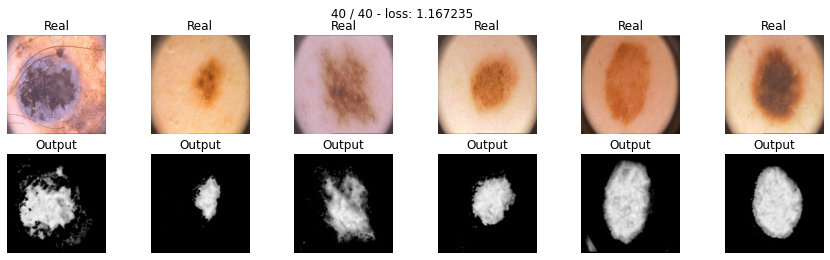

Training complete in 6m 59s


In [ ]:
max_epochs = 40
optim = torch.optim.Adam(model.parameters(), lr=0.001)
model, losses = train(model, optim, bce_loss, max_epochs, data_tr, data_val)
torch.save(model.state_dict(), 'SegNet_3.pth')
torch.save(model.state_dict(), '/content/gdrive/MyDrive/Colab Notebooks/dls advanced/SegNet_3.pth')

In [ ]:
with open('/content/gdrive/MyDrive/Colab Notebooks/dls advanced/losses_segnet_3.json', 'w') as fp:
    json.dump(losses, fp)

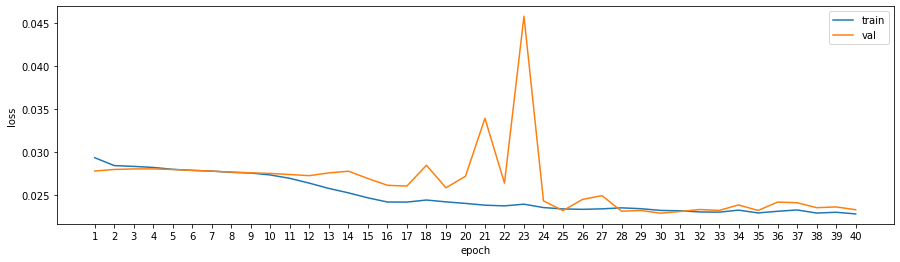

In [ ]:
x_range = range(1, max_epochs+1)
plt.plot(x_range, losses['train'], label='train');
plt.plot(x_range, losses['val'], label='val');
plt.legend()
plt.xticks(x_range)
plt.xlabel('epoch')
plt.ylabel('loss')
plt.show();

In [ ]:
# загрузка модели
model = SegNet()
model.load_state_dict(torch.load('/content/gdrive/MyDrive/Colab Notebooks/dls advanced/SegNet_3.pth', map_location=torch.device(DEVICE)))

with open('/content/gdrive/MyDrive/Colab Notebooks/dls advanced/losses_segnet_3.json') as json_file:
    losses_segnet_2 = json.load(json_file)

In [ ]:
print(f'IoU for SegNet with BCE loss')
print('IoU metric on TRAIN: {:.5f}'.format(score_model(model, iou_pytorch, data_tr)))
print('IoU metric on VAL: {:.5f}'.format(score_model(model, iou_pytorch, data_val)))
print('IoU metric on TEST: {:.5f}'.format(score_model(model, iou_pytorch, data_ts)))

IoU for SegNet with BCE loss
IoU metric on TRAIN: 0.71957
IoU metric on VAL: 0.74279
IoU metric on TEST: 0.70032


In [ ]:
pred_test = predict(model, data_ts)

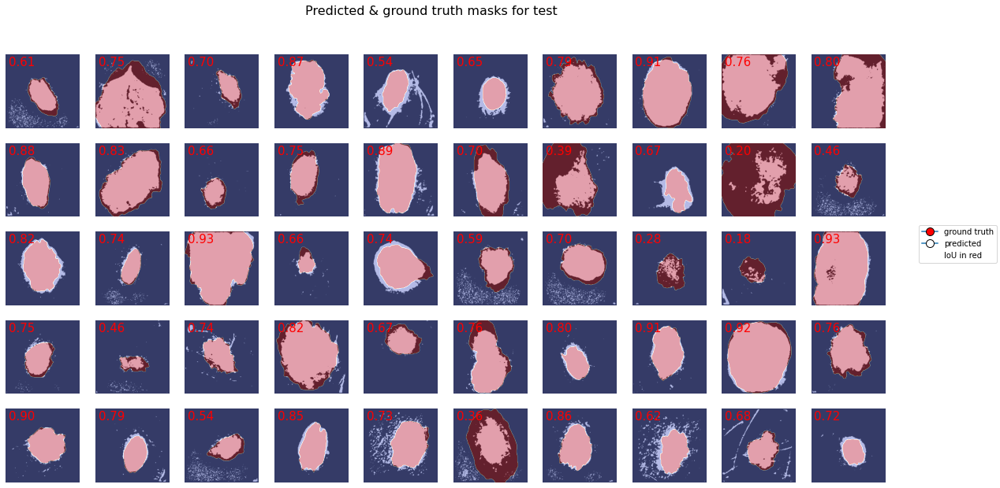

In [ ]:
plot_pred(pred_test, data_ts.dataset)

Ответьте себе на вопрос: не переобучается ли моя модель?

-----------------------------------------------------------------------------------------

## Дополнительные функции потерь [2 балла] 

 В данном разделе вам потребуется имплементировать две функции потерь:
 DICE и Focal loss. 
 Если у вас что-то не учится, велика вероятность, что вы ошиблись или учите слишком мало эпох, прежде чем бить тревогу попробуйте перебрать различные варианты и убедитесь, что во всех других сетапах сеть достигает желанного результата. СПОЙЛЕР: учиться она будет при всех лоссах, предложенных в этом задании.


**1. Dice coefficient:** Учитывая две маски $X$ и $Y$, общая метрика для измерения расстояния между этими двумя масками задается следующим образом:

$$D(X,Y)=\frac{2|X\cap Y|}{|X|+|Y|}$$

Эта функция не является дифференцируемой, но это необходимое свойство для градиентного спуска. В данном случае мы можем приблизить его с помощью:

$$\mathcal L_D(X,Y) = 1-\frac{1}{256 \times 256} \times \frac{\sum_i2X_iY_i}{\sum_iX_i+Y_i}.$$

Не забудьте подумать о численной нестабильности, возникающей в математической формуле.


In [ ]:
def dice_loss(y_pred, y_real):
    # B x C x H x W
    # B x 1 x H x W
    y_pred = torch.sigmoid(y_pred)
    y_real = y_real.squeeze(1)  # BATCH x 1 x H x W => BATCH x H x W
    y_pred = y_pred.squeeze(1)
    # B x H x W

    SMOOTH = 1e-8
    inter = torch.sum(y_pred * y_real, (2,1)) # B
    real_sum = torch.sum(y_real, (2,1)) # B
    pred_sum = torch.sum(y_pred, (2,1)) # B
    loss = 1 - (2*inter + SMOOTH) / (real_sum + pred_sum + SMOOTH)
    return loss.mean()

Проводим тестирование:

#### SegNet dice

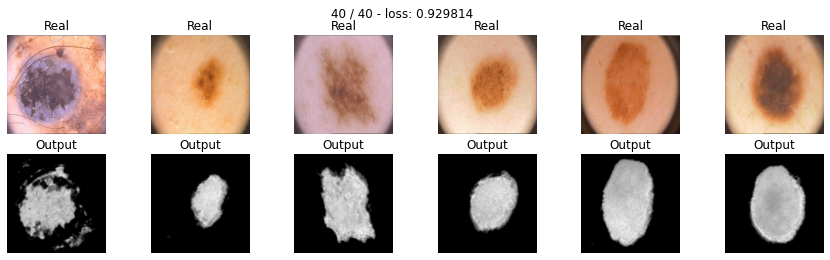

Training complete in 7m 8s


In [ ]:
model_dice = SegNet().to(DEVICE)

max_epochs = 40
optimaizer = torch.optim.Adam(model_dice.parameters())
model_dice, losses_dice = train(model_dice, optimaizer, dice_loss, max_epochs, data_tr, data_val)
torch.save(model_dice.state_dict(), 'model_dice_2.pth')
torch.save(model_dice.state_dict(), '/content/gdrive/MyDrive/Colab Notebooks/dls advanced/model_dice_2.pth')

In [ ]:
import json

with open('/content/gdrive/MyDrive/Colab Notebooks/dls advanced/losses_dice_2.json', 'w') as fp:
    json.dump(losses_dice, fp)

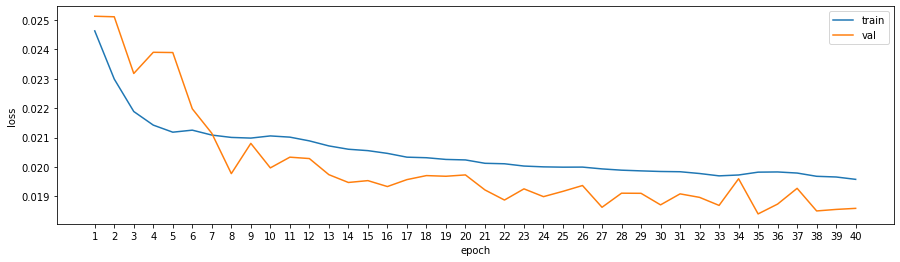

In [ ]:
x_range = range(1, max_epochs+1)
plt.plot(x_range, losses_dice['train'], label='train');
plt.plot(x_range, losses_dice['val'], label='val');
plt.legend()
plt.xticks(x_range)
plt.xlabel('epoch')
plt.ylabel('loss')
plt.show();

In [ ]:
# загрузка модели
model_dice = SegNet()
model_dice.load_state_dict(torch.load('/content/gdrive/MyDrive/Colab Notebooks/dls advanced/model_dice_2.pth', map_location=torch.device(DEVICE)))

with open('/content/gdrive/MyDrive/Colab Notebooks/dls advanced/losses_dice_2.json') as json_file:
    losses_dice = json.load(json_file)

In [ ]:
print(f'IoU for SegNet with dice loss')
print('IoU metric on TRAIN: {:.5f}'.format(score_model(model_dice, iou_pytorch, data_tr)))
print('IoU metric on VAL: {:.5f}'.format(score_model(model_dice, iou_pytorch, data_val)))
print('IoU metric on TEST: {:.5f}'.format(score_model(model_dice, iou_pytorch, data_ts)))

IoU for SegNet with dice loss
IoU metric on TRAIN: 0.77003
IoU metric on VAL: 0.80848
IoU metric on TEST: 0.74726


In [ ]:
pred_dice_test = predict(model_dice, data_ts)

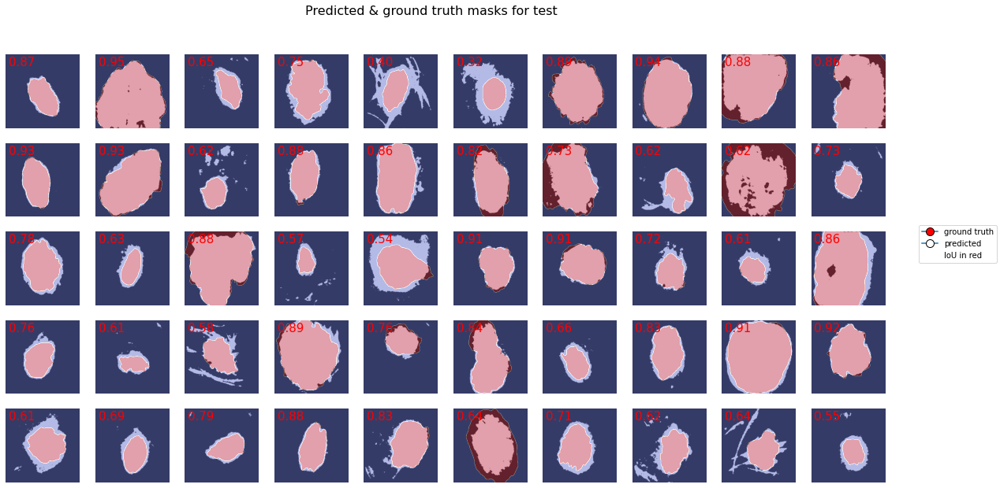

In [ ]:
plot_pred(pred_dice_test, data_ts.dataset)

[**2. Focal loss:**](https://arxiv.org/pdf/1708.02002.pdf) 

Окей, мы уже с вами умеем делать BCE loss:

$$\mathcal L_{BCE}(y, \hat y) = -\sum_i \left[y_i\log\sigma(\hat y_i) + (1-y_i)\log(1-\sigma(\hat y_i))\right].$$

Проблема с этой потерей заключается в том, что она имеет тенденцию приносить пользу классу **большинства** (фоновому) по отношению к классу **меньшинства** ( переднему). Поэтому обычно применяются весовые коэффициенты к каждому классу:

$$\mathcal L_{wBCE}(y, \hat y) = -\sum_i \alpha_i\left[y_i\log\sigma(\hat y_i) + (1-y_i)\log(1-\sigma(\hat y_i))\right].$$

Традиционно вес $\alpha_i$ определяется как обратная частота класса этого пикселя $i$, так что наблюдения миноритарного класса весят больше по отношению к классу большинства.

Еще одним недавним дополнением является взвешенный пиксельный вариант, которая взвешивает каждый пиксель по степени уверенности, которую мы имеем в предсказании этого пикселя.

$$\mathcal L_{focal}(y, \hat y) = -\sum_i \left[\left(1-\sigma(\hat y_i)\right)^\gamma y_i\log\sigma(\hat y_i) + (1-y_i)\log(1-\sigma(\hat y_i))\right].$$

Зафиксируем значение $\gamma=2$.

--------------------------------------------------------------------------------


In [ ]:
def focal_loss(y_pred, y_real, gamma = 2):
    SMOOTH = 1e-8

    #y_pred =  # hint: torch.clamp clamps all elements into the range [ min, max ] ???????????
    p = torch.sigmoid(y_pred)
    pos_class = y_real * ((1 - p)**gamma) * torch.log(p + SMOOTH)
    neg_class = (1 - y_real) * (p**gamma) * torch.log(1 - p + SMOOTH)

    loss = -1 * (pos_class + neg_class)
    return loss.mean()

#### SegNet focal

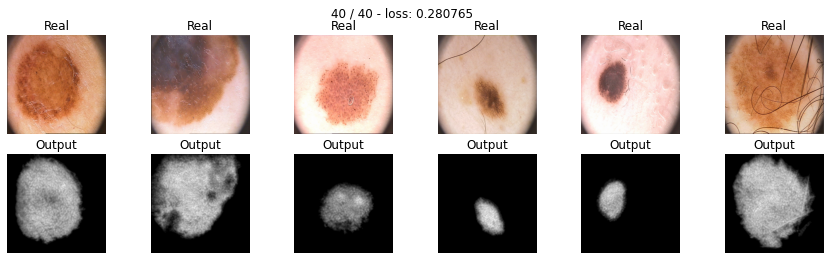

Training complete in 16m 51s


In [ ]:
model_focal = SegNet().to(DEVICE)

max_epochs = 40
optimaizer = optim.Adam(model_focal.parameters(), lr=0.001)
model_focal, losses_focal = train(model_focal, optimaizer, focal_loss, max_epochs, data_tr, data_val)
torch.save(model_focal.state_dict(), 'segnet_focal.pth')
torch.save(model_focal.state_dict(), '/content/gdrive/MyDrive/Colab Notebooks/dls advanced/segnet_focal.pth')

In [ ]:
import json

with open('/content/gdrive/MyDrive/Colab Notebooks/dls advanced/losses_focal.json', 'w') as fp:
    json.dump(losses_focal, fp)

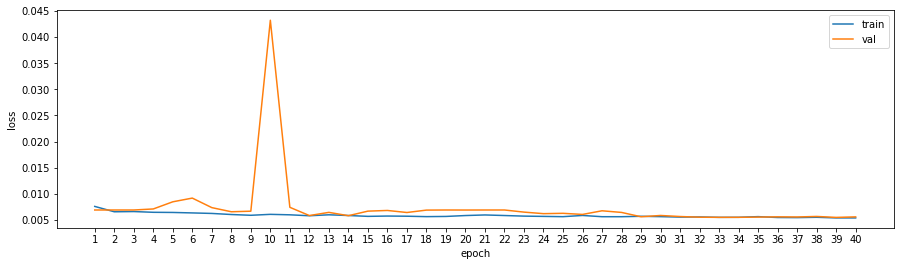

In [ ]:
x_range = range(1, max_epochs+1)
plt.plot(x_range, losses_focal['train'], label='train');
plt.plot(x_range, losses_focal['val'], label='val');
plt.legend()
plt.xticks(x_range)
plt.xlabel('epoch')
plt.ylabel('loss')
plt.show();

In [ ]:
# загрузка модели
model_focal = SegNet()
model_focal.load_state_dict(torch.load('/content/gdrive/MyDrive/Colab Notebooks/dls advanced/segnet_focal.pth', map_location=torch.device(DEVICE)))

with open('/content/gdrive/MyDrive/Colab Notebooks/dls advanced/losses_focal.json') as json_file:
    losses_focal = json.load(json_file)

In [ ]:
print(f'IoU for SegNet with focal loss')
print('IoU metric on TRAIN: {:.5f}'.format(score_model(model_focal, iou_pytorch, data_tr)))
print('IoU metric on VAL: {:.5f}'.format(score_model(model_focal, iou_pytorch, data_val)))
print('IoU metric on TEST: {:.5f}'.format(score_model(model_focal, iou_pytorch, data_ts)))

IoU for SegNet with focal loss
IoU metric on TRAIN: 0.77462
IoU metric on VAL: 0.79111
IoU metric on TEST: 0.80040


In [ ]:
pred_focal_test = predict(model_focal, data_ts)

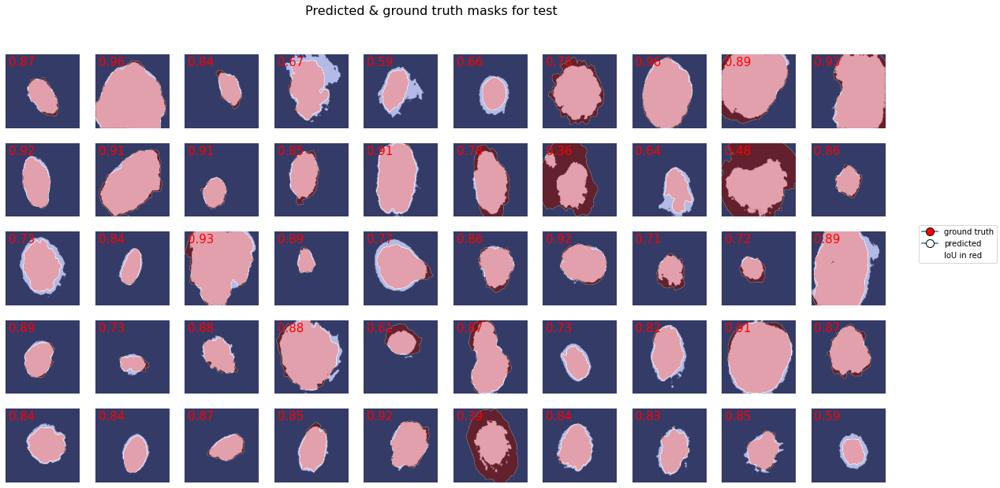

In [ ]:
plot_pred(pred_focal_test, data_ts.dataset)

## Hausdorff Loss

Davood Karimi, and Septimiu E. Salcudean "Reducing the Hausdorff Distance in Medical Image
Segmentation with Convolutional Neural Networks
": https://arxiv.org/pdf/1904.10030v1.pdf

3D Medical Image Segmentation With Distance Transform Maps: https://github.com/JunMa11/SegWithDistMap/tree/5a67153bc730eb82de396ef63f57594f558e23cd

$$\mathcal Loss(q, p) = \frac{1}{\Omega}  \sum_\Omega ((p-q)^2 \circ (d_p^\alpha + d_q^\alpha))$$

где:

$p$ - реальная маска

$q$ - предсказанная маска

$d_p$, $d_q$ - карта расстояний для масок соответственно

$\alpha$ - гиперпараметр (в статье = 2)

$\circ$ - поэлементное перемножение

Distance Transform Map (карта расстояний):

- вне маски 0
- на грнице 1
- чем дальше от границы, тем больше значение

https://docs.scipy.org/doc/scipy/reference/generated/scipy.ndimage.distance_transform_edt.html

In [ ]:
from scipy.ndimage import distance_transform_edt as edt

@torch.no_grad()
def compute_map(pred: torch.Tensor) -> torch.Tensor:
    pred = pred.detach().cpu().numpy()
    B = pred.shape[0]
    map = np.zeros_like(pred, dtype=pred.dtype)

    for b in range(B):
        fg_mask = pred[b].astype(bool)

        if fg_mask.any():
            bg_mask = ~fg_mask
            map[b] = edt(fg_mask) + edt(bg_mask) - 1

    return torch.tensor(map, dtype=torch.float32).to(DEVICE)

In [ ]:
def hd_loss(y_pred, y_true):

    y_pred = torch.sigmoid(y_pred)
    y_pred = y_pred.squeeze(1) # B x H x W
    y_true = y_true.squeeze(1)

    pred_dtm = compute_map(y_pred)
    true_dtm = compute_map(y_true)

    pred_error = torch.pow((y_pred - y_true.float()), 2)
    dist = torch.pow(pred_dtm, 2) + torch.pow(true_dtm, 2)

    our_mul = pred_error * dist # B x H x W
    sum = torch.sum(our_mul, (1,2)) / (y_true.shape[1] * y_true.shape[2])

    return sum.mean()

#### SegNet hausdorff

In [ ]:
model_hd = SegNet().to(DEVICE)
# model

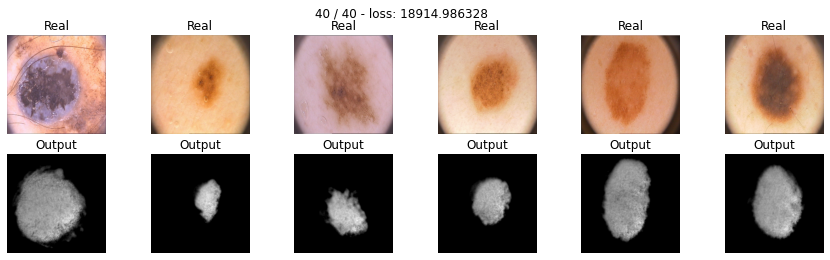

Training complete in 8m 36s


In [ ]:
max_epochs = 40
optim = torch.optim.Adam(model_hd.parameters(), lr=0.001)
model_hd, losses_hd = train(model_hd, optim, hd_loss, max_epochs, data_tr, data_val)
torch.save(model_hd.state_dict(), 'model_hd_02.pth')
torch.save(model_hd.state_dict(), '/content/gdrive/MyDrive/Colab Notebooks/dls advanced/model_hd_02.pth')

In [ ]:
import json

with open('/content/gdrive/MyDrive/Colab Notebooks/dls advanced/losses_hd_02.json', 'w') as fp:
    json.dump(losses_hd, fp)

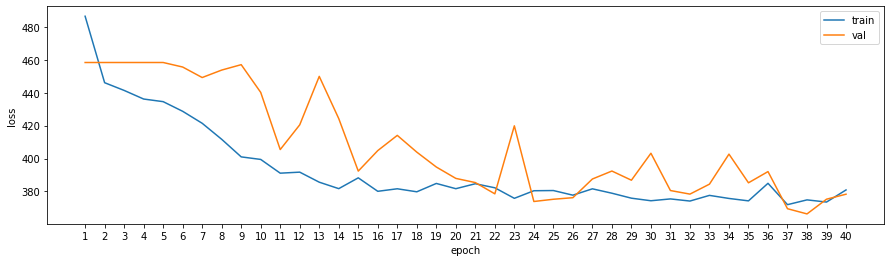

In [ ]:
x_range = range(1, max_epochs+1)
plt.plot(x_range, losses_hd['train'], label='train');
plt.plot(x_range, losses_hd['val'], label='val');
plt.legend()
plt.xticks(x_range)
plt.xlabel('epoch')
plt.ylabel('loss')
plt.show();

In [ ]:
# загрузка модели
model_hd = SegNet()
model_hd.load_state_dict(torch.load('/content/gdrive/MyDrive/Colab Notebooks/dls advanced/model_hd_02.pth', map_location=torch.device(DEVICE)))

with open('/content/gdrive/MyDrive/Colab Notebooks/dls advanced/losses_hd_02.json') as json_file:
    losses_hd = json.load(json_file)

In [ ]:
print(f'IoU for SegNet with hausdorff loss')
print('IoU metric on TRAIN: {:.5f}'.format(score_model(model_hd, iou_pytorch, data_tr)))
print('IoU metric on VAL: {:.5f}'.format(score_model(model_hd, iou_pytorch, data_val)))
print('IoU metric on TEST: {:.5f}'.format(score_model(model_hd, iou_pytorch, data_ts)))

IoU for SegNet with hausdorff loss
IoU metric on TRAIN: 0.67973
IoU metric on VAL: 0.68541
IoU metric on TEST: 0.67370


In [ ]:
pred_hd_test = predict(model_hd, data_ts)

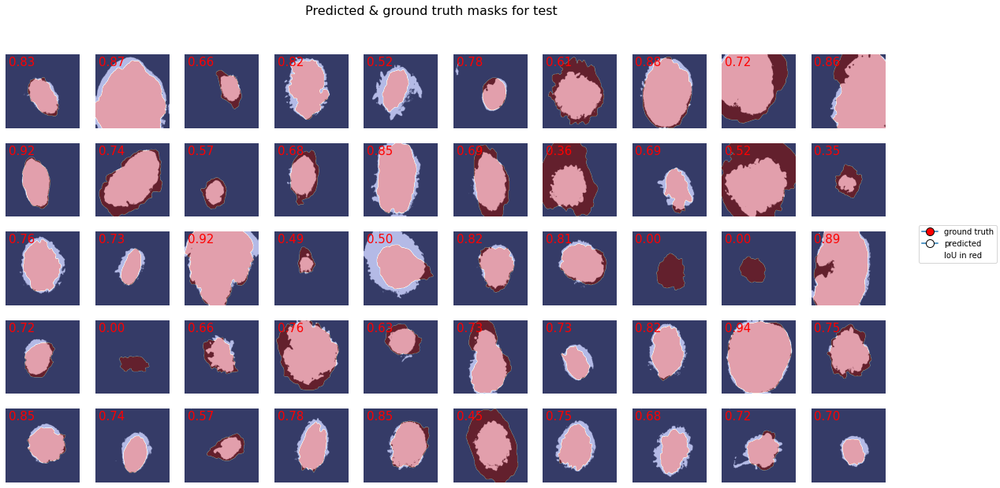

In [ ]:
plot_pred(pred_hd_test, data_ts.dataset)

#### SegNet focal + dice

In [ ]:
def focal_dice_loss(y_pred, y_real):
    return focal_loss(y_pred, y_real) + dice_loss(y_pred, y_real)

In [ ]:
model_focal_dice = SegNet().to(DEVICE)
# model

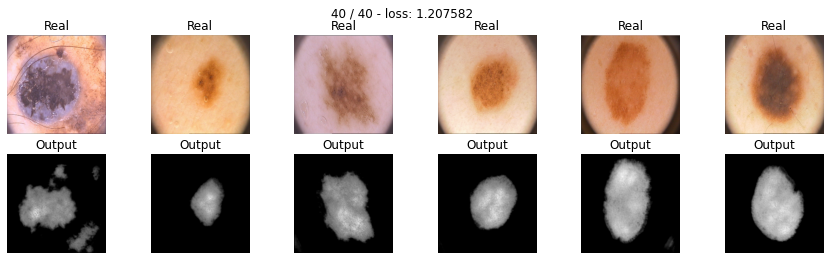

Training complete in 7m 7s


In [ ]:
max_epochs = 40
optim = torch.optim.Adam(model_focal_dice.parameters(), lr=0.001)
model_focal_dice, losses_focal_dice = train(model_focal_dice, optim, focal_dice_loss, max_epochs, data_tr, data_val)
torch.save(model_focal_dice.state_dict(), 'model_focal_dice.pth')
torch.save(model_focal_dice.state_dict(), '/content/gdrive/MyDrive/Colab Notebooks/dls advanced/model_focal_dice.pth')

In [ ]:
import json

with open('/content/gdrive/MyDrive/Colab Notebooks/dls advanced/losses_focal_dice.json', 'w') as fp:
    json.dump(losses_focal_dice, fp)

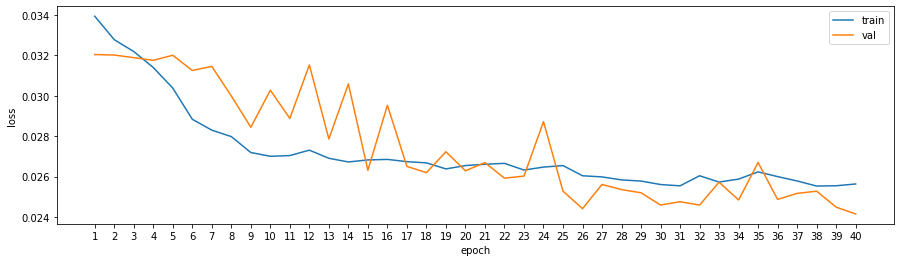

In [ ]:
x_range = range(1, max_epochs+1)
plt.plot(x_range, losses_focal_dice['train'], label='train');
plt.plot(x_range, losses_focal_dice['val'], label='val');
plt.legend()
plt.xticks(x_range)
plt.xlabel('epoch')
plt.ylabel('loss')
plt.show();

In [ ]:
# загрузка модели
model_focal_dice = SegNet()
model_focal_dice.load_state_dict(torch.load('/content/gdrive/MyDrive/Colab Notebooks/dls advanced/model_focal_dice.pth', map_location=torch.device(DEVICE)))

with open('/content/gdrive/MyDrive/Colab Notebooks/dls advanced/losses_focal_dice.json') as json_file:
    losses_focal_dice = json.load(json_file)

In [ ]:
print(f'IoU for SegNet with focal + dice loss')
print('IoU metric on TRAIN: {:.5f}'.format(score_model(model_focal_dice, iou_pytorch, data_tr)))
print('IoU metric on VAL: {:.5f}'.format(score_model(model_focal_dice, iou_pytorch, data_val)))
print('IoU metric on TEST: {:.5f}'.format(score_model(model_focal_dice, iou_pytorch, data_ts)))

IoU for SegNet with focal + dice loss
IoU metric on TRAIN: 0.79849
IoU metric on VAL: 0.82839
IoU metric on TEST: 0.78681


In [ ]:
pred_focal_dice_test = predict(model_focal_dice, data_ts)

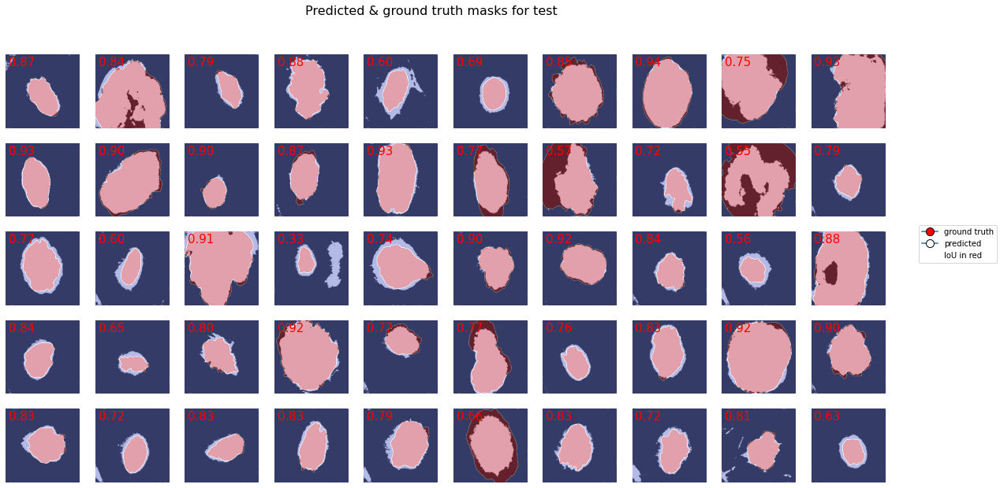

In [ ]:
plot_pred(pred_focal_dice_test, data_ts.dataset)

#### SegNet focal + dice + huasdorff

In [ ]:
model_focal_dice_hd = SegNet().to(DEVICE)
# model

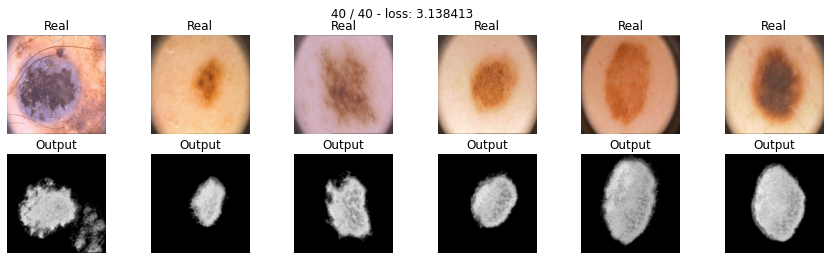

Training complete in 8m 35s


In [ ]:
max_epochs = 40
optim = torch.optim.Adam(model_focal_dice_hd.parameters(), lr=0.001)
model_focal_dice_hd, losses_focal_dice_hd = train(model_focal_dice_hd, optim, focal_dice_hd_loss, max_epochs, data_tr, data_val)
torch.save(model_focal_dice_hd.state_dict(), 'model_focal_dice_hd.pth')
torch.save(model_focal_dice_hd.state_dict(), '/content/gdrive/MyDrive/Colab Notebooks/dls advanced/model_focal_dice_hd.pth')

In [ ]:
import json

with open('/content/gdrive/MyDrive/Colab Notebooks/dls advanced/losses_focal_dice_hd.json', 'w') as fp:
    json.dump(losses_focal_dice_hd, fp)

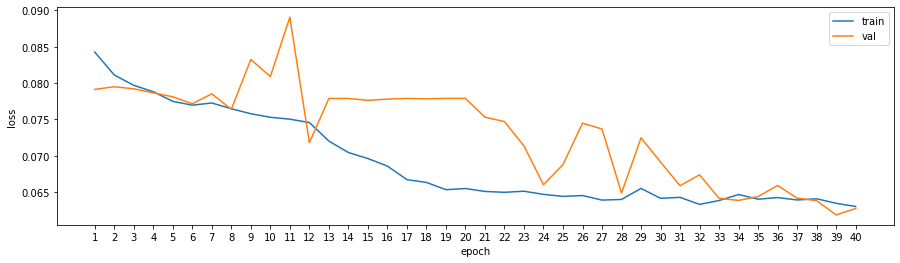

In [ ]:
x_range = range(1, max_epochs+1)
plt.plot(x_range, losses_focal_dice_hd['train'], label='train');
plt.plot(x_range, losses_focal_dice_hd['val'], label='val');
plt.legend()
plt.xticks(x_range)
plt.xlabel('epoch')
plt.ylabel('loss')
plt.show();

In [ ]:
# загрузка модели
model_focal_dice_hd = SegNet()
model_focal_dice_hd.load_state_dict(torch.load('/content/gdrive/MyDrive/Colab Notebooks/dls advanced/model_focal_dice_hd.pth', map_location=torch.device(DEVICE)))

with open('/content/gdrive/MyDrive/Colab Notebooks/dls advanced/losses_focal_dice_hd.json') as json_file:
    losses_focal_dice_hd = json.load(json_file)

In [ ]:
print(f'IoU for SegNet with focal + dice + hausdorff loss')
print('IoU metric on TRAIN: {:.5f}'.format(score_model(model_focal_dice_hd, iou_pytorch, data_tr)))
print('IoU metric on VAL: {:.5f}'.format(score_model(model_focal_dice_hd, iou_pytorch, data_val)))
print('IoU metric on TEST: {:.5f}'.format(score_model(model_focal_dice_hd, iou_pytorch, data_ts)))

IoU for SegNet with focal + dice + hausdorff loss
IoU metric on TRAIN: 0.75718
IoU metric on VAL: 0.75699
IoU metric on TEST: 0.77256


In [ ]:
pred_focal_dice_hd_test = predict(model_focal_dice_hd, data_ts)

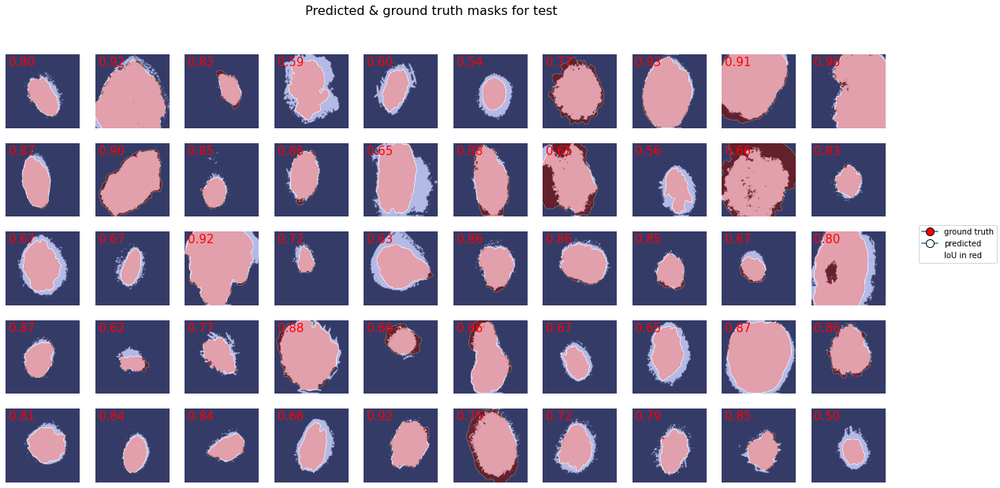

In [ ]:
plot_pred(pred_focal_dice_hd_test, data_ts.dataset)

#### SegNet focal + hausdorff

In [ ]:
def focal_hd_loss(y_pred, y_real):
    return focal_loss(y_pred, y_real) + hd_loss(y_pred, y_real) / 10000

In [ ]:
model_focal_hd = SegNet().to(DEVICE)
# model

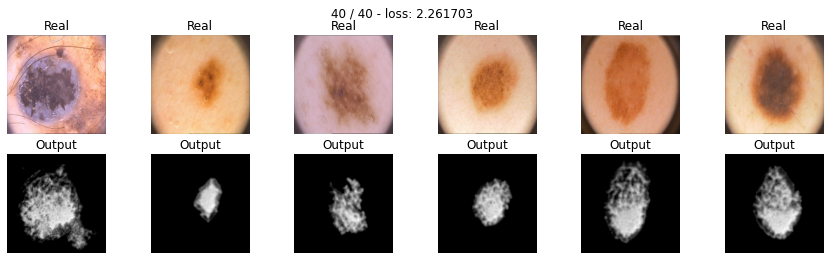

Training complete in 8m 37s


In [ ]:
max_epochs = 40
optim = torch.optim.Adam(model_focal_hd.parameters(), lr=0.001)
model_focal_hd, losses_focal_hd = train(model_focal_hd, optim, focal_hd_loss, max_epochs, data_tr, data_val)
torch.save(model_focal_hd.state_dict(), 'model_focal_hd.pth')
torch.save(model_focal_hd.state_dict(), '/content/gdrive/MyDrive/Colab Notebooks/dls advanced/model_focal_hd.pth')

In [ ]:
import json

with open('/content/gdrive/MyDrive/Colab Notebooks/dls advanced/losses_focal_hd.json', 'w') as fp:
    json.dump(losses_focal_hd, fp)

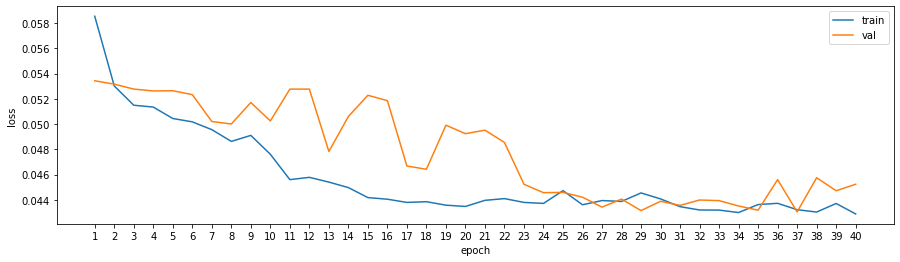

In [ ]:
x_range = range(1, max_epochs+1)
plt.plot(x_range, losses_focal_hd['train'], label='train');
plt.plot(x_range, losses_focal_hd['val'], label='val');
plt.legend()
plt.xticks(x_range)
plt.xlabel('epoch')
plt.ylabel('loss')
plt.show();

In [ ]:
# загрузка модели
model_focal_hd = SegNet()
model_focal_hd.load_state_dict(torch.load('/content/gdrive/MyDrive/Colab Notebooks/dls advanced/model_focal_hd.pth', map_location=torch.device(DEVICE)))

with open('/content/gdrive/MyDrive/Colab Notebooks/dls advanced/losses_focal_hd.json') as json_file:
    losses_focal_hd = json.load(json_file)

In [ ]:
print(f'IoU for SegNet with focal + hausdorff loss')
print('IoU metric on TRAIN: {:.5f}'.format(score_model(model_focal_hd, iou_pytorch, data_tr)))
print('IoU metric on VAL: {:.5f}'.format(score_model(model_focal_hd, iou_pytorch, data_val)))
print('IoU metric on TEST: {:.5f}'.format(score_model(model_focal_hd, iou_pytorch, data_ts)))

IoU for SegNet with focal + hausdorff loss
IoU metric on TRAIN: 0.70780
IoU metric on VAL: 0.72216
IoU metric on TEST: 0.70983


In [ ]:
pred_focal_hd_test = predict(model_focal_hd, data_ts)

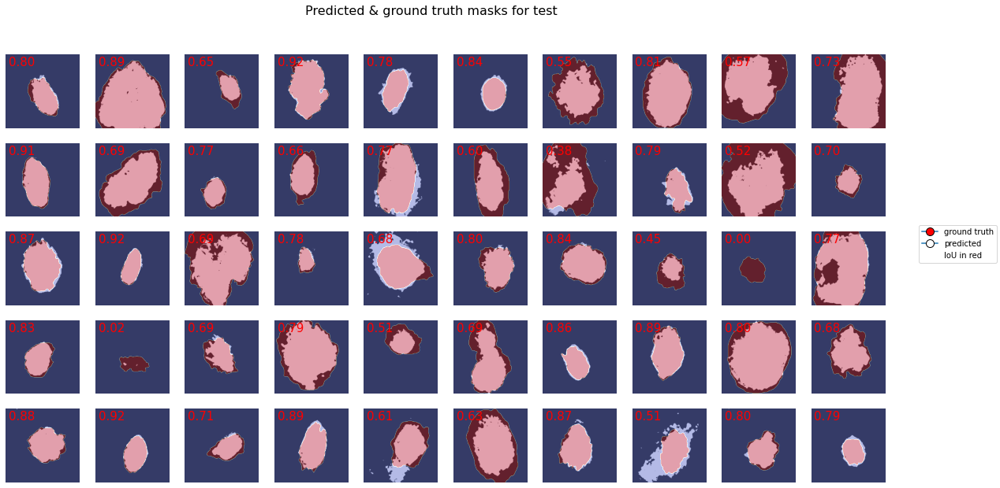

In [ ]:
plot_pred(pred_focal_hd_test, data_ts.dataset)

-----------------------------------------------------------------------------------------

# U-Net [2 балла]

[**U-Net**](https://arxiv.org/abs/1505.04597) — это архитектура нейронной сети, которая получает изображение и выводит его. Первоначально он был задуман для семантической сегментации (как мы ее будем использовать), но он настолько успешен, что с тех пор используется в других контекстах. Получая на вход медицинское изображение, он выведет изображение в оттенках серого, где интенсивность каждого пикселя зависит от вероятности того, что этот пиксель принадлежит интересующей нас области.

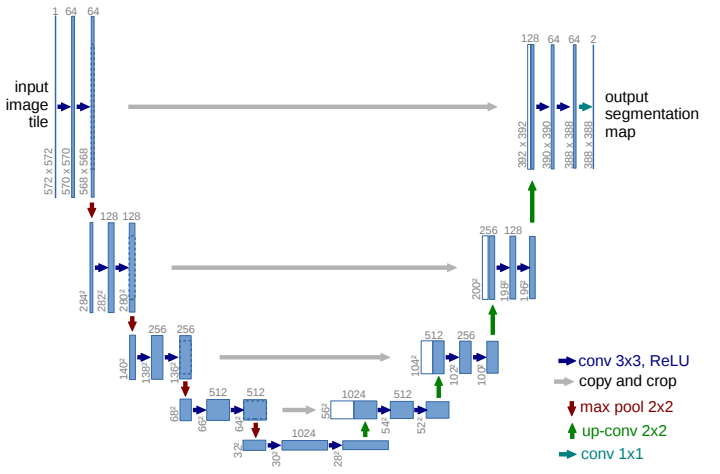

У нас в архитектуре все так же существует энкодер и декодер, как в **SegNet**, но отличительной особеностью данной модели являются *skip-conenctions*, соединяющие части декодера и энкодера. То есть для того чтобы передать на вход декодера тензор, мы конкатенируем симметричный выход с энкодера и выход предыдущего слоя декодера.

* Ronneberger, Olaf, Philipp Fischer, and Thomas Brox. "[U-Net: Convolutional networks for biomedical image segmentation.](https://arxiv.org/pdf/1505.04597.pdf)" International Conference on Medical image computing and computer-assisted intervention. Springer, Cham, 2015.

> The network architecture is illustrated in Figure 1. It consists of a contracting
path (left side) and an expansive path (right side). The contracting path follows
the typical architecture of a convolutional network. It consists of the repeated
application of two 3x3 convolutions (unpadded convolutions), each followed by
a rectified linear unit (ReLU) and a 2x2 max pooling operation with stride 2
for downsampling. At each downsampling step we double the number of feature
channels. Every step in the expansive path consists of an **upsampling of the
feature map followed by a 2x2 convolution (“up-convolution”)** that halves the
number of feature channels, a concatenation with the correspondingly cropped
feature map from the contracting path, and two 3x3 convolutions, each followed by a ReLU. The cropping is necessary due to the loss of border pixels in
every convolution. At the final layer a 1x1 convolution is used to map each 64-
component feature vector to the desired number of classes. In total the network
has 23 convolutional layers.

In [ ]:
def double_conv(in_c: int,  out_c: int):
    block = nn.Sequential(
            nn.Conv2d(in_c, out_c, kernel_size=3, padding=1),
            nn.BatchNorm2d(out_c, eps=1e-05, momentum=0.1),
            nn.ReLU(inplace=True),
            nn.Conv2d(out_c, out_c, kernel_size=3, padding=1),
            nn.BatchNorm2d(out_c, eps=1e-05, momentum=0.1),
            nn.ReLU(inplace=True),
      )
    return block
  
def up_conv(in_c: int,  out_c: int):
    block = nn.Sequential(
        nn.Upsample(scale_factor=2, mode='nearest'),
        nn.Conv2d(in_c, out_c, kernel_size=2, stride=1, padding='same')
    )
    return block

In [ ]:
class UNet(nn.Module):
    def __init__(self, in_channels: int = 3, out_channels: int = 1):
        super().__init__()

        # encoder
        self.enc_conv1 = double_conv(in_channels, 32) # 256 -> 128
        self.enc_conv2 = double_conv(32, 64) # 128 -> 64
        self.enc_conv3 = double_conv(64, 128) # 64 -> 32
        self.enc_conv4 = double_conv(128, 256) # 32 -> 16
        self.pool = nn.MaxPool2d(kernel_size=2, stride=2)

        # bottleneck
        self.bottleneck_conv = double_conv(256, 512)

        # decoder (upsampling)
        self.upsample4 = up_conv(512, 256) # 16 -> 32
        self.dec_conv4 = double_conv(512, 256)
        self.upsample3 = up_conv(256, 128) # 32 -> 64
        self.dec_conv3 = double_conv(256, 128)
        self.upsample2 = up_conv(128, 64)  # 64 -> 128
        self.dec_conv2 = double_conv(128, 64)
        self.upsample1 = up_conv(64, 32)  # 128 -> 256
        self.dec_conv1 = double_conv(64, 32)

        self.out_conv = nn.Conv2d(32, out_channels, kernel_size=1) #  изменяем количество каналов

    def forward(self, x):
        # encoder
        e1 = self.enc_conv1(x) # 256 x 32
        e2 = self.enc_conv2(self.pool(e1)) # 128 x 64
        e3 = self.enc_conv3(self.pool(e2)) # 64 x 128
        e4 = self.enc_conv4(self.pool(e3)) # 32 x 256

        # bottleneck
        b = self.bottleneck_conv(self.pool(e4)) # 16 x 512

        # decoder
        d4 = self.upsample4(b) # 32 x 256
        d4 = torch.cat((d4, e4), dim=1)
        d4 = self.dec_conv4(d4)

        d3 = self.upsample3(d4) # 64 x 128
        d3 = torch.cat((d3, e3), dim=1)
        d3 = self.dec_conv3(d3)

        d2 = self.upsample2(d3) # 128 x 64
        d2 = torch.cat((d2, e2), dim=1)
        d2 = self.dec_conv2(d2)
        
        d1 = self.upsample1(d2) # 256 x 32
        d1 = torch.cat((d1, e1), dim=1)
        d1 = self.dec_conv1(d1)

        d = self.out_conv(d1)
        # no activation
        return d

#### U-Net BCE

In [ ]:
unet_model = UNet().to(DEVICE)

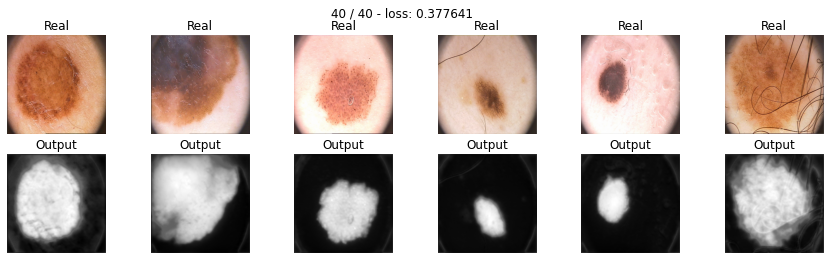

5: 161.0
Training complete in 0m 13s


FileNotFoundError: ignored

In [ ]:
max_epochs = 40
optimizer = torch.optim.Adam(unet_model.parameters(), lr=0.001)
unet_model, losses_unet = train(unet_model, optimizer, bce_loss, max_epochs, data_tr, data_val)
torch.save(unet_model.state_dict(), 'unet_model.pth')
torch.save(unet_model.state_dict(), '/content/gdrive/MyDrive/Colab Notebooks/dls advanced/unet_model.pth')

In [ ]:
import json

with open('/content/gdrive/MyDrive/Colab Notebooks/dls advanced/losses_unet.json', 'w') as fp:
    json.dump(losses_unet, fp)

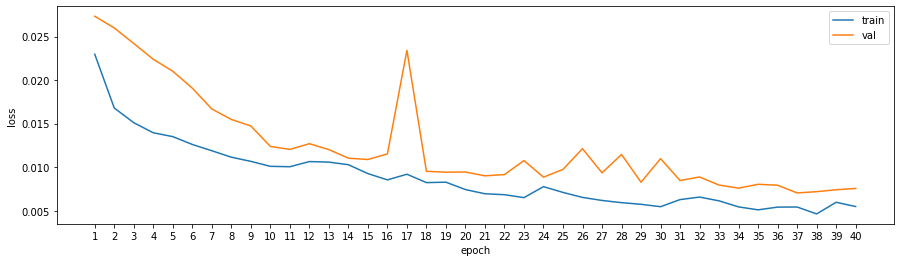

In [ ]:
x_range = range(1, max_epochs+1)
plt.plot(x_range, losses_unet['train'], label='train');
plt.plot(x_range, losses_unet['val'], label='val');
plt.legend()
plt.xticks(x_range)
plt.xlabel('epoch')
plt.ylabel('loss')
plt.show();

In [ ]:
# загрузка модели
unet_model = UNet()
unet_model.load_state_dict(torch.load('/content/gdrive/MyDrive/Colab Notebooks/dls advanced/unet_model.pth', map_location=torch.device(DEVICE)))

with open('/content/gdrive/MyDrive/Colab Notebooks/dls advanced/losses_unet.json') as json_file:
    losses_unet = json.load(json_file)

In [ ]:
print(f'IoU U-Net with BCE loss')
print('IoU metric on TRAIN: {:.5f}'.format(score_model(unet_model, iou_pytorch, data_tr)))
print('IoU metric on VAL: {:.5f}'.format(score_model(unet_model, iou_pytorch, data_val)))
print('IoU metric on TEST: {:.5f}'.format(score_model(unet_model, iou_pytorch, data_ts)))

IoU U-Net with BCE loss
IoU metric on TRAIN: 0.82128
IoU metric on VAL: 0.86517
IoU metric on TEST: 0.82920


In [ ]:
pred_unet_test = predict(unet_model, data_ts)

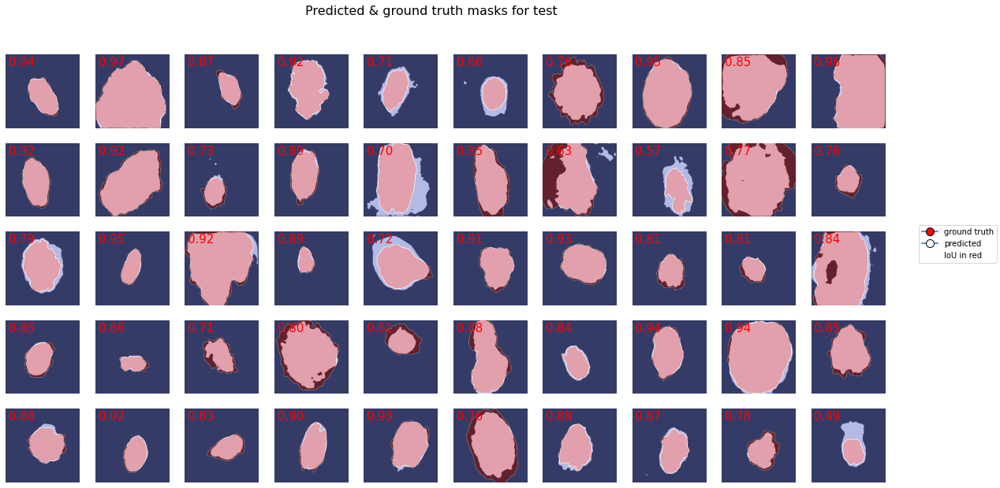

In [ ]:
plot_pred(pred_unet_test, data_ts.dataset)

#### U-Net dice

In [ ]:
unet_model_dice = UNet().to(DEVICE)

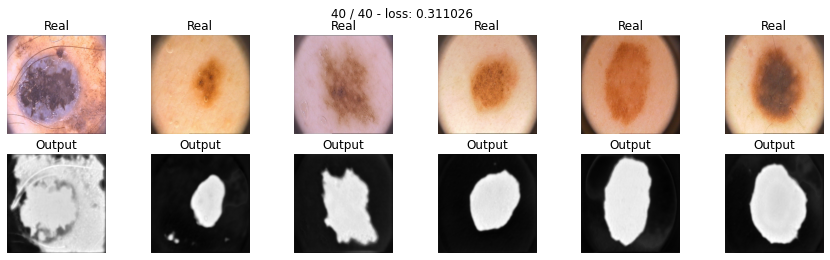

Training complete in 3m 30s


In [ ]:
max_epochs = 40
optimizer = torch.optim.Adam(unet_model_dice.parameters(), lr=0.001)
unet_model_dice, losses_unet_dice = train(unet_model_dice, optimizer, dice_loss, max_epochs, data_tr, data_val)
torch.save(unet_model_dice.state_dict(), 'unet_model_dice_2.pth')
torch.save(unet_model_dice.state_dict(), '/content/gdrive/MyDrive/Colab Notebooks/dls advanced/unet_model_dice_2.pth')

In [ ]:
import json

with open('/content/gdrive/MyDrive/Colab Notebooks/dls advanced/losses_unet_dice_2.json', 'w') as fp:
    json.dump(losses_unet_dice, fp)

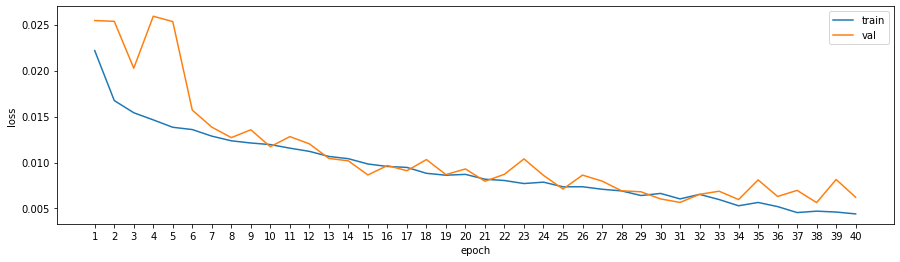

In [ ]:
x_range = range(1, max_epochs+1)
plt.plot(x_range, losses_unet_dice['train'], label='train');
plt.plot(x_range, losses_unet_dice['val'], label='val');
plt.legend()
plt.xticks(x_range)
plt.xlabel('epoch')
plt.ylabel('loss')
plt.show();

In [ ]:
# загрузка модели
unet_model_dice = UNet()
unet_model_dice.load_state_dict(torch.load('/content/gdrive/MyDrive/Colab Notebooks/dls advanced/unet_model_dice_2.pth', map_location=torch.device(DEVICE)))

with open('/content/gdrive/MyDrive/Colab Notebooks/dls advanced/losses_unet_dice_2.json') as json_file:
    losses_unet_dice = json.load(json_file)

In [ ]:
print(f'IoU for U-Net with dice loss')
print('IoU metric on TRAIN: {:.5f}'.format(score_model(unet_model_dice, iou_pytorch, data_tr)))
print('IoU metric on VAL: {:.5f}'.format(score_model(unet_model_dice, iou_pytorch, data_val)))
print('IoU metric on TEST: {:.5f}'.format(score_model(unet_model_dice, iou_pytorch, data_ts)))

IoU for U-Net with dice loss
IoU metric on TRAIN: 0.82096
IoU metric on VAL: 0.85644
IoU metric on TEST: 0.81548


In [ ]:
pred_unet_dice_test = predict(unet_model_dice, data_ts)

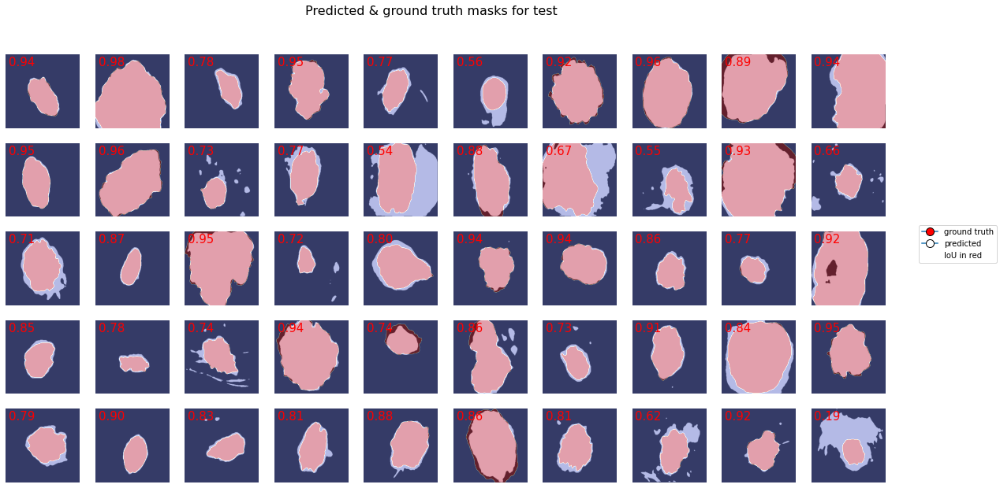

In [ ]:
plot_pred(pred_unet_dice_test, data_ts.dataset)

#### U-Net focal

In [ ]:
unet_model_focal = UNet().to(DEVICE)

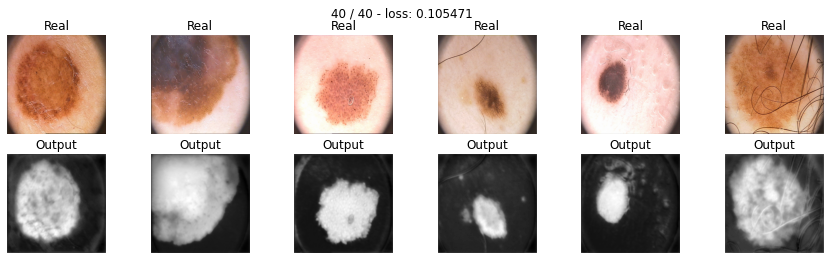

Training complete in 9m 14s


In [ ]:
max_epochs = 40
optimizer = torch.optim.Adam(unet_model_focal.parameters(), lr=0.001)
unet_model_focal, losses_unet_focal = train(unet_model_focal, optimizer, focal_loss, max_epochs, data_tr, data_val)
torch.save(unet_model_focal.state_dict(), 'unet_model_focal.pth')
torch.save(unet_model_focal.state_dict(), '/content/gdrive/MyDrive/Colab Notebooks/dls advanced/unet_model_focal.pth')

In [ ]:
import json

with open('/content/gdrive/MyDrive/Colab Notebooks/dls advanced/losses_unet_focal.json', 'w') as fp:
    json.dump(losses_unet_focal, fp)

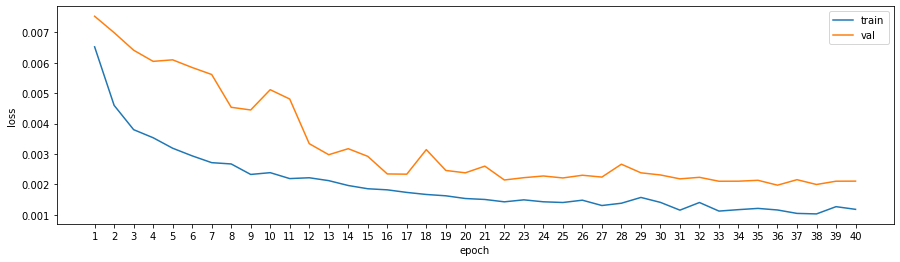

In [ ]:
x_range = range(1, max_epochs+1)
plt.plot(x_range, losses_unet_focal['train'], label='train');
plt.plot(x_range, losses_unet_focal['val'], label='val');
plt.legend()
plt.xticks(x_range)
plt.xlabel('epoch')
plt.ylabel('loss')
plt.show();

In [ ]:
# загрузка модели
unet_model_focal = UNet()
unet_model_focal.load_state_dict(torch.load('/content/gdrive/MyDrive/Colab Notebooks/dls advanced/unet_model_focal.pth', map_location=torch.device(DEVICE)))

with open('/content/gdrive/MyDrive/Colab Notebooks/dls advanced/losses_unet_focal.json') as json_file:
    losses_unet_focal = json.load(json_file)

In [ ]:
print(f'IoU for U-Net with focal loss')
print('IoU metric on TRAIN: {:.5f}'.format(score_model(unet_model_focal, iou_pytorch, data_tr)))
print('IoU metric on VAL: {:.5f}'.format(score_model(unet_model_focal, iou_pytorch, data_val)))
print('IoU metric on TEST: {:.5f}'.format(score_model(unet_model_focal, iou_pytorch, data_ts)))

IoU for U-Net with focal loss
IoU metric on TRAIN: 0.82888
IoU metric on VAL: 0.86943
IoU metric on TEST: 0.82183


In [ ]:
pred_unet_focal_test = predict(unet_model_focal, data_ts)

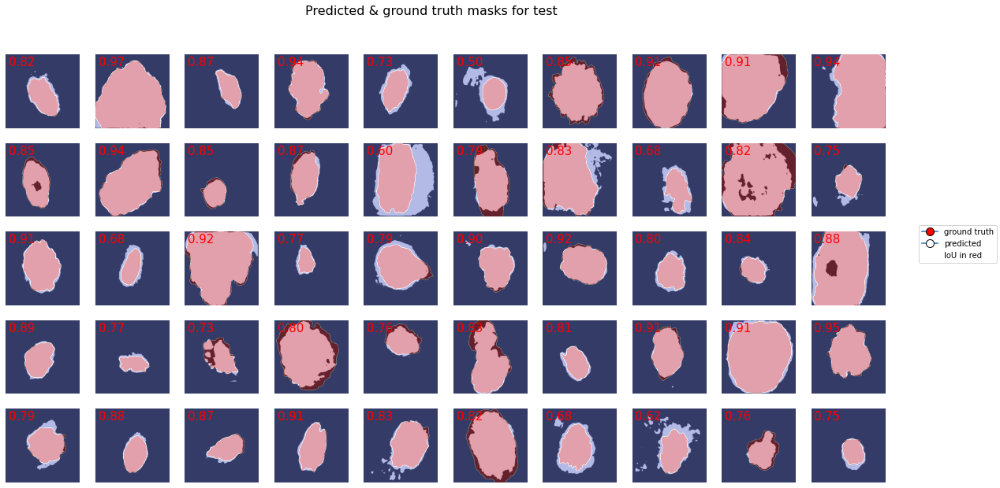

In [ ]:
plot_pred(pred_unet_focal_test, data_ts.dataset)

#### U-Net hausdorff

In [ ]:
unet_hd = UNet().to(DEVICE)
# model

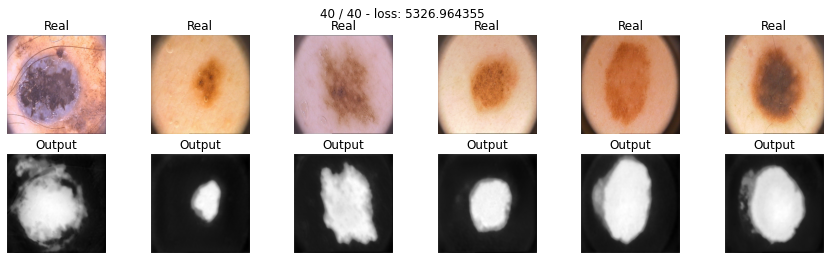

Training complete in 5m 5s


In [ ]:
max_epochs = 40
optim = torch.optim.Adam(unet_hd.parameters(), lr=0.001)
unet_hd, losses_unet_hd = train(unet_hd, optim, hd_loss, max_epochs, data_tr, data_val)
torch.save(unet_hd.state_dict(), 'unet_hd_2.pth')
torch.save(unet_hd.state_dict(), '/content/gdrive/MyDrive/Colab Notebooks/dls advanced/unet_hd_2.pth')

In [ ]:
import json

with open('/content/gdrive/MyDrive/Colab Notebooks/dls advanced/losses_unet_hd_2.json', 'w') as fp:
    json.dump(losses_unet_hd, fp)

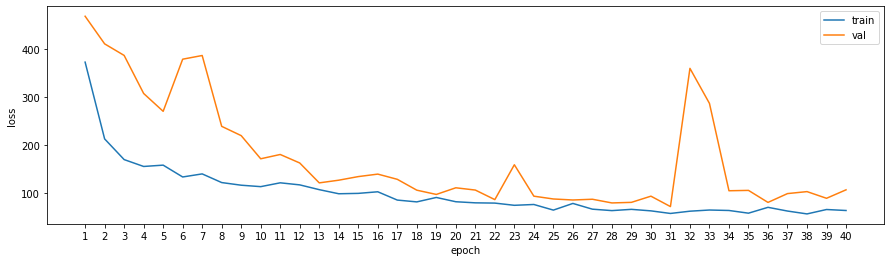

In [ ]:
x_range = range(1, max_epochs+1)
plt.plot(x_range, losses_unet_hd['train'], label='train');
plt.plot(x_range, losses_unet_hd['val'], label='val');
plt.legend()
plt.xticks(x_range)
plt.xlabel('epoch')
plt.ylabel('loss')
plt.show();

In [ ]:
# загрузка модели
unet_hd = UNet()
unet_hd.load_state_dict(torch.load('/content/gdrive/MyDrive/Colab Notebooks/dls advanced/unet_hd_2.pth', map_location=torch.device(DEVICE)))

with open('/content/gdrive/MyDrive/Colab Notebooks/dls advanced/losses_unet_hd_2.json') as json_file:
    losses_unet_hd = json.load(json_file)

In [ ]:
print(f'IoU for U-Net with hausdorff loss')
print('IoU metric on TRAIN: {:.5f}'.format(score_model(unet_hd, iou_pytorch, data_tr)))
print('IoU metric on VAL: {:.5f}'.format(score_model(unet_hd, iou_pytorch, data_val)))
print('IoU metric on TEST: {:.5f}'.format(score_model(unet_hd, iou_pytorch, data_ts)))

IoU for U-Net with hausdorff loss
IoU metric on TRAIN: 0.78279
IoU metric on VAL: 0.84749
IoU metric on TEST: 0.80576


In [ ]:
pred_unet_hd_test = predict(unet_hd, data_ts)

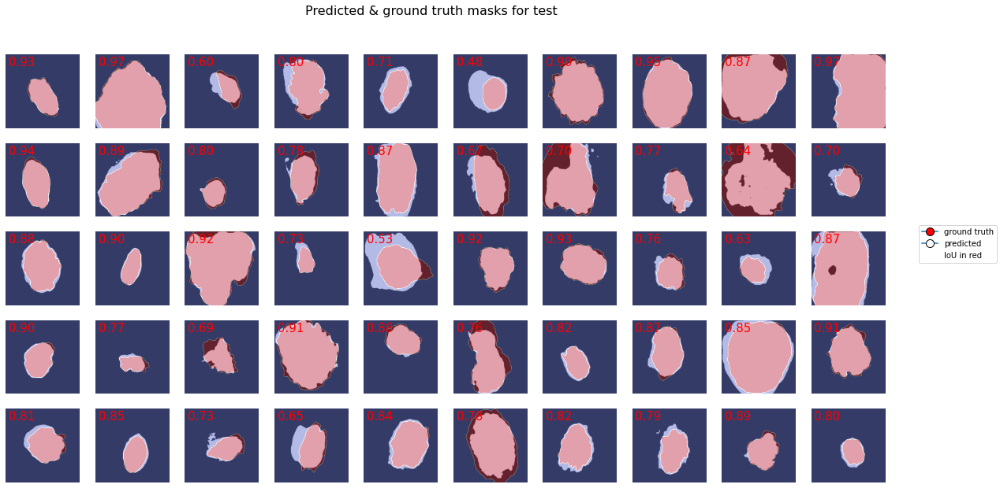

In [ ]:
plot_pred(pred_unet_hd_test, data_ts.dataset)

#### U-Net focal + dice

In [ ]:
unet_focal_dice = UNet().to(DEVICE)
# model

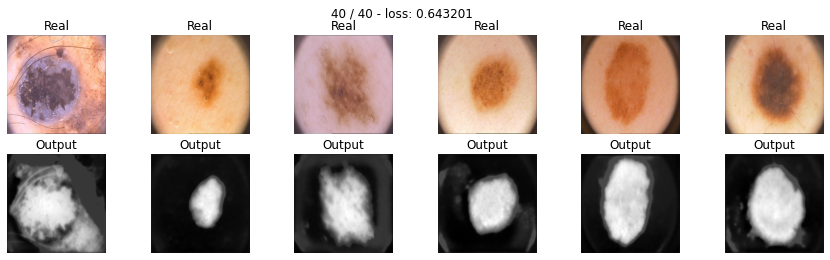

Training complete in 3m 31s


In [ ]:
max_epochs = 40
optim = torch.optim.Adam(unet_focal_dice.parameters(), lr=0.001)
unet_focal_dice, losses_unet_focal_dice = train(unet_focal_dice, optim, focal_dice_loss, max_epochs, data_tr, data_val)
torch.save(unet_focal_dice.state_dict(), 'unet_focal_dice.pth')
torch.save(unet_focal_dice.state_dict(), '/content/gdrive/MyDrive/Colab Notebooks/dls advanced/unet_focal_dice.pth')

In [ ]:
import json

with open('/content/gdrive/MyDrive/Colab Notebooks/dls advanced/losses_unet_focal_dice.json', 'w') as fp:
    json.dump(losses_unet_focal_dice, fp)

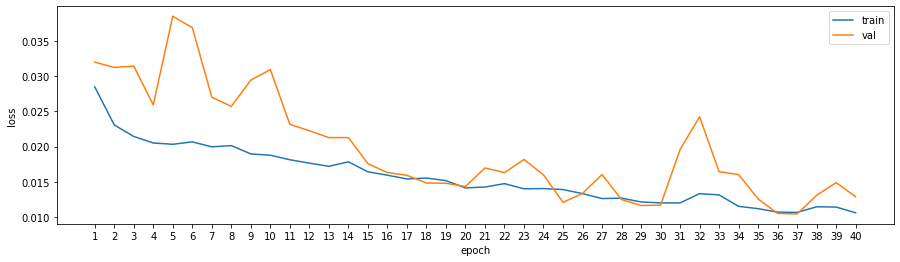

In [ ]:
x_range = range(1, max_epochs+1)
plt.plot(x_range, losses_unet_focal_dice['train'], label='train');
plt.plot(x_range, losses_unet_focal_dice['val'], label='val');
plt.legend()
plt.xticks(x_range)
plt.xlabel('epoch')
plt.ylabel('loss')
plt.show();

In [ ]:
# загрузка модели
unet_focal_dice = UNet()
unet_focal_dice.load_state_dict(torch.load('/content/gdrive/MyDrive/Colab Notebooks/dls advanced/unet_focal_dice.pth', map_location=torch.device(DEVICE)))

with open('/content/gdrive/MyDrive/Colab Notebooks/dls advanced/losses_unet_focal_dice.json') as json_file:
    losses_unet_focal_dice = json.load(json_file)

In [ ]:
print(f'IoU for U-Net with focal + dice loss')
print('IoU metric on TRAIN: {:.5f}'.format(score_model(unet_focal_dice, iou_pytorch, data_tr)))
print('IoU metric on VAL: {:.5f}'.format(score_model(unet_focal_dice, iou_pytorch, data_val)))
print('IoU metric on TEST: {:.5f}'.format(score_model(unet_focal_dice, iou_pytorch, data_ts)))

IoU for U-Net with focal + dice loss
IoU metric on TRAIN: 0.78888
IoU metric on VAL: 0.81412
IoU metric on TEST: 0.78656


In [ ]:
pred_unet_focal_dice_test = predict(unet_focal_dice, data_ts)

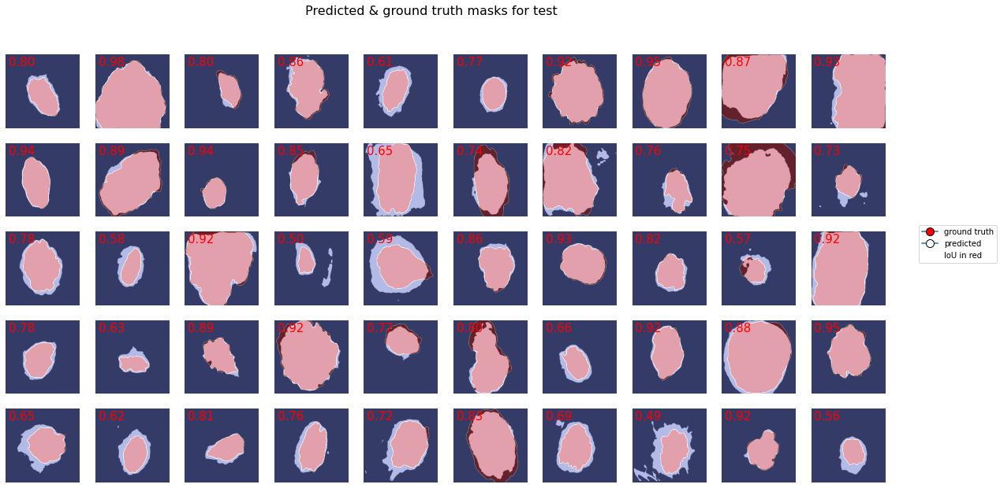

In [ ]:
plot_pred(pred_unet_focal_dice_test, data_ts.dataset)

#### U-Net focal + dice + hausdorff

In [ ]:
def focal_dice_hd_loss(y_pred, y_real):
    return focal_loss(y_pred, y_real) + dice_loss(y_pred, y_real) + hd_loss(y_pred, y_real) / 10000

In [ ]:
unet_focal_dice_hd = UNet().to(DEVICE)
# model

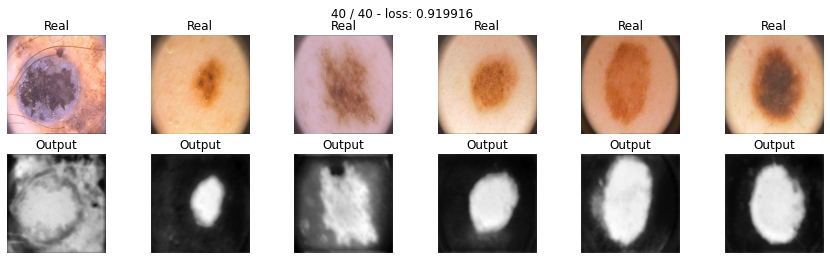

Training complete in 5m 6s


In [ ]:
max_epochs = 40
optim = torch.optim.Adam(unet_focal_dice_hd.parameters(), lr=0.001)
unet_focal_dice_hd, losses_unet_focal_dice_hd = train(unet_focal_dice_hd, optim, focal_dice_hd_loss, max_epochs, data_tr, data_val)
torch.save(unet_focal_dice_hd.state_dict(), 'unet_focal_dice_hd.pth')
torch.save(unet_focal_dice_hd.state_dict(), '/content/gdrive/MyDrive/Colab Notebooks/dls advanced/unet_focal_dice_hd.pth')

In [ ]:
import json

with open('/content/gdrive/MyDrive/Colab Notebooks/dls advanced/losses_unet_focal_dice_hd.json', 'w') as fp:
    json.dump(losses_unet_focal_dice_hd, fp)

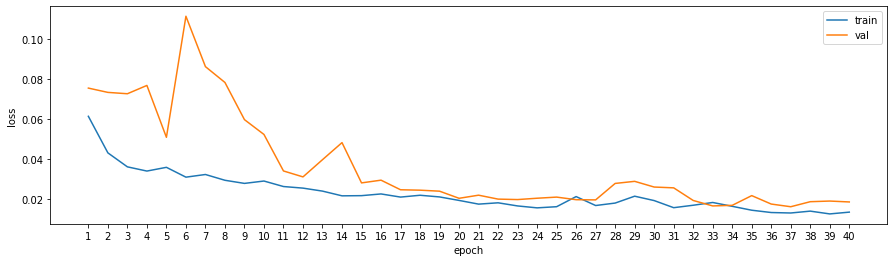

In [ ]:
x_range = range(1, max_epochs+1)
plt.plot(x_range, losses_unet_focal_dice_hd['train'], label='train');
plt.plot(x_range, losses_unet_focal_dice_hd['val'], label='val');
plt.legend()
plt.xticks(x_range)
plt.xlabel('epoch')
plt.ylabel('loss')
plt.show();

In [ ]:
# загрузка модели
unet_focal_dice_hd = UNet()
unet_focal_dice_hd.load_state_dict(torch.load('/content/gdrive/MyDrive/Colab Notebooks/dls advanced/unet_focal_dice_hd.pth', map_location=torch.device(DEVICE)))

with open('/content/gdrive/MyDrive/Colab Notebooks/dls advanced/losses_unet_focal_dice_hd.json') as json_file:
    losses_unet_focal_dice_hd = json.load(json_file)

In [ ]:
print(f'IoU for U-Net with focal + dice + hausdorff loss')
print('IoU metric on TRAIN: {:.5f}'.format(score_model(unet_focal_dice_hd, iou_pytorch, data_tr)))
print('IoU metric on VAL: {:.5f}'.format(score_model(unet_focal_dice_hd, iou_pytorch, data_val)))
print('IoU metric on TEST: {:.5f}'.format(score_model(unet_focal_dice_hd, iou_pytorch, data_ts)))

IoU for U-Net with focal + dice + hausdorff loss
IoU metric on TRAIN: 0.81208
IoU metric on VAL: 0.84104
IoU metric on TEST: 0.80819


In [ ]:
pred_unet_focal_dice_hd_test = predict(unet_focal_dice_hd, data_ts)

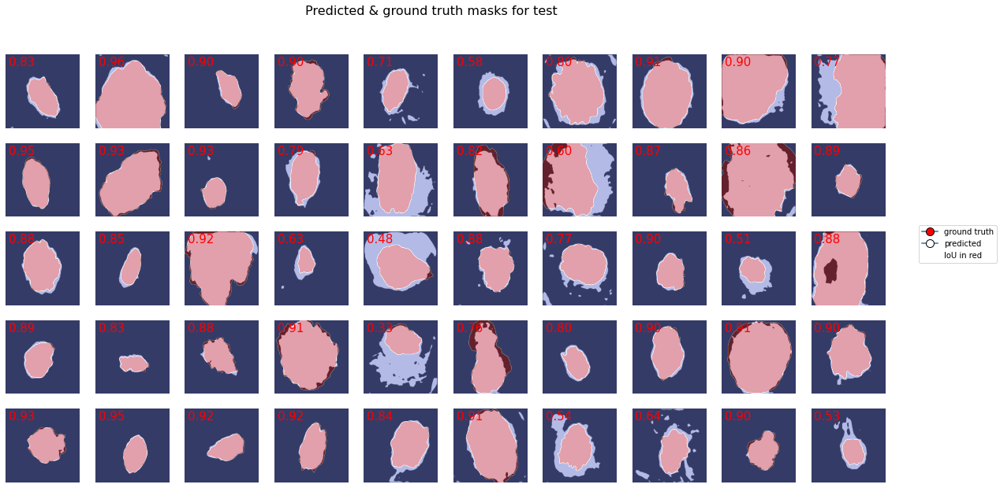

In [ ]:
plot_pred(pred_unet_focal_dice_hd_test, data_ts.dataset)

#### U-Net focal + hausdorff

In [ ]:
unet_focal_hd = UNet().to(DEVICE)
# model

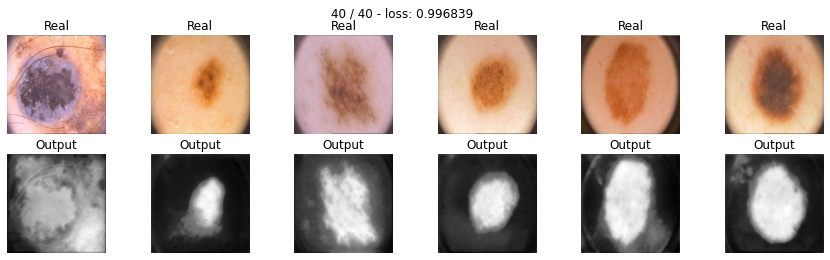

Training complete in 5m 2s


In [ ]:
max_epochs = 40
optim = torch.optim.Adam(unet_focal_hd.parameters(), lr=0.001)
unet_focal_hd, losses_unet_focal_hd = train(unet_focal_hd, optim, focal_hd_loss, max_epochs, data_tr, data_val)
torch.save(unet_focal_hd.state_dict(), 'unet_focal_hd.pth')
torch.save(unet_focal_hd.state_dict(), '/content/gdrive/MyDrive/Colab Notebooks/dls advanced/unet_focal_hd.pth')

In [ ]:
import json

with open('/content/gdrive/MyDrive/Colab Notebooks/dls advanced/losses_unet_focal_hd.json', 'w') as fp:
    json.dump(losses_unet_focal_hd, fp)

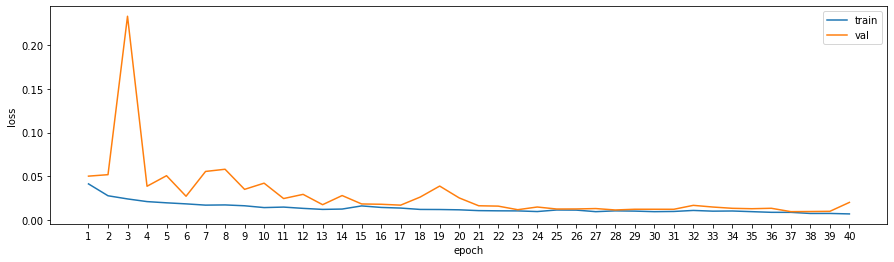

In [ ]:
x_range = range(1, max_epochs+1)
plt.plot(x_range, losses_unet_focal_hd['train'], label='train');
plt.plot(x_range, losses_unet_focal_hd['val'], label='val');
plt.legend()
plt.xticks(x_range)
plt.xlabel('epoch')
plt.ylabel('loss')
plt.show();

In [ ]:
# загрузка модели
unet_focal_hd = UNet()
unet_focal_hd.load_state_dict(torch.load('/content/gdrive/MyDrive/Colab Notebooks/dls advanced/unet_focal_hd.pth', map_location=torch.device(DEVICE)))

with open('/content/gdrive/MyDrive/Colab Notebooks/dls advanced/losses_unet_focal_hd.json') as json_file:
    losses_unet_focal_hd = json.load(json_file)

In [ ]:
print(f'IoU for U-Net with focal + hausdorff loss')
print('IoU metric on TRAIN: {:.5f}'.format(score_model(unet_focal_hd, iou_pytorch, data_tr)))
print('IoU metric on VAL: {:.5f}'.format(score_model(unet_focal_hd, iou_pytorch, data_val)))
print('IoU metric on TEST: {:.5f}'.format(score_model(unet_focal_hd, iou_pytorch, data_ts)))

IoU for U-Net with focal + hausdorff loss
IoU metric on TRAIN: 0.73390
IoU metric on VAL: 0.76119
IoU metric on TEST: 0.71405


In [ ]:
pred_unet_focal_hd_test = predict(unet_focal_hd, data_ts)

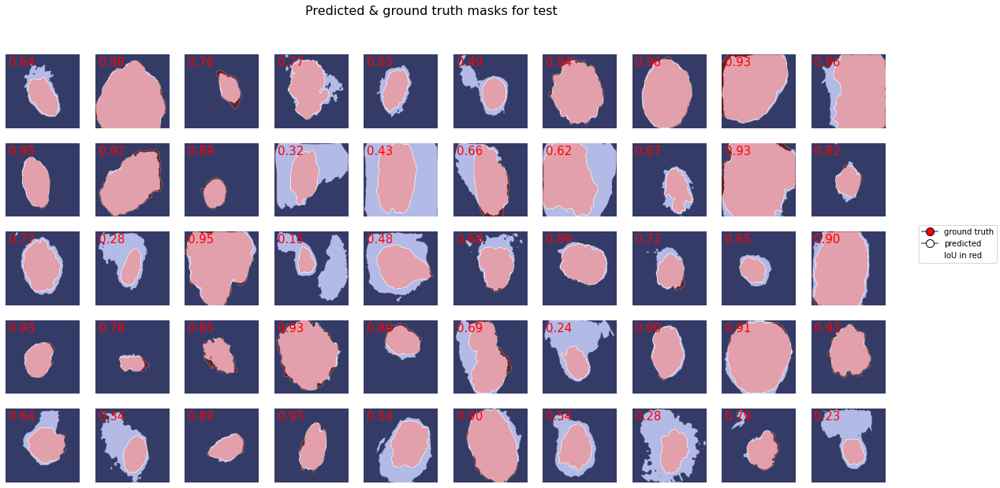

In [ ]:
plot_pred(pred_unet_focal_hd_test, data_ts.dataset)

Новая модель путем изменения типа пулинга:

 **Max-Pooling** for the downsampling and **nearest-neighbor Upsampling** for the upsampling.

Down-sampling:

        conv = nn.Conv2d(3, 64, 3, padding=1)
        pool = nn.MaxPool2d(3, 2, padding=1)

Up-Sampling

        upsample = nn.Upsample(32)
        conv = nn.Conv2d(64, 64, 3, padding=1)

Замените max-pooling на convolutions с stride=2 и upsampling на transpose-convolutions с stride=2.


In [ ]:
class UNet2(nn.Module):
    def __init__(self, in_channels: int = 3, out_channels: int = 1):
        super().__init__()

        # encoder
        self.enc_conv1 = double_conv(in_channels, 32)
        self.pool_conv1 = nn.Conv2d(32, 32, kernel_size=2, stride=2) # 256 -> 128
        self.enc_conv2 = double_conv(32, 64)
        self.pool_conv2 = nn.Conv2d(64, 64, kernel_size=2, stride=2) # 128 -> 64
        self.enc_conv3 = double_conv(64, 128)
        self.pool_conv3 = nn.Conv2d(128, 128, kernel_size=2, stride=2) # 64 -> 32
        self.enc_conv4 = double_conv(128, 256)
        self.pool_conv4 = nn.Conv2d(256, 256, kernel_size=2, stride=2) # 32 -> 16

        # bottleneck
        self.bottleneck_conv = double_conv(256, 512)

        # decoder (upsampling)
        self.upconv4 = nn.ConvTranspose2d(512, 256, kernel_size=2, stride=2) # 16 -> 32
        self.dec_conv4 = double_conv(512, 256)
        self.upconv3 = nn.ConvTranspose2d(256, 128, kernel_size=2, stride=2) # 32 -> 64
        self.dec_conv3 = double_conv(256, 128)
        self.upconv2 = nn.ConvTranspose2d(128, 64, kernel_size=2, stride=2)  # 64 -> 128
        self.dec_conv2 = double_conv(128, 64)
        self.upconv1 = nn.ConvTranspose2d(64, 32, kernel_size=2, stride=2)  # 128 -> 256
        self.dec_conv1 = double_conv(64, 32)

        self.out_conv = nn.Conv2d(32, out_channels, kernel_size=1) #  изменяем количество каналов

    def forward(self, x):
        # encoder
        e1 = self.enc_conv1(x) # 256
        e2 = self.enc_conv2(self.pool_conv1(e1)) # 128
        e3 = self.enc_conv3(self.pool_conv2(e2)) # 64
        e4 = self.enc_conv4(self.pool_conv3(e3)) # 32

        # bottleneck
        b = self.bottleneck_conv(self.pool_conv4(e4)) # 16

        # decoder
        d4 = self.upconv4(b) # 32
        d4 = torch.cat((d4, e4), dim=1)
        d4 = self.dec_conv4(d4)

        d3 = self.upconv3(d4) # 64
        d3 = torch.cat((d3, e3), dim=1)
        d3 = self.dec_conv3(d3)

        d2 = self.upconv2(d3) # 32
        d2 = torch.cat((d2, e2), dim=1)
        d2 = self.dec_conv2(d2)

        d1 = self.upconv1(d2) # 16
        d1 = torch.cat((d1, e1), dim=1)
        d1 = self.dec_conv1(d1)
        
        d = self.out_conv(d1)
        # no activation
        return d


#### U-Net 2 BCE

In [ ]:
unet2_model = UNet2().to(DEVICE)

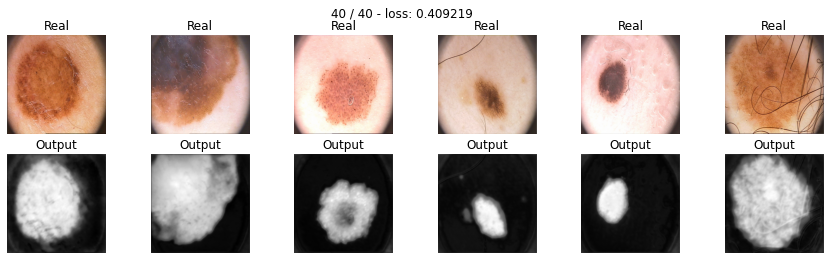

5: 2179.0
Training complete in 0m 11s


In [ ]:
max_epochs = 40
optimizer = torch.optim.Adam(unet2_model.parameters(), lr=0.001)
unet2_model, losses = train(unet2_model, optimizer, bce_loss, max_epochs, data_tr, data_val)
torch.save(unet2_model.state_dict(), 'unet2_model.pth')
torch.save(unet2_model.state_dict(), '/content/gdrive/MyDrive/Colab Notebooks/dls advanced/unet2_model.pth')

In [ ]:
with open('/content/gdrive/MyDrive/Colab Notebooks/dls advanced/losses_unet2.json', 'w') as fp:
    json.dump(losses, fp)

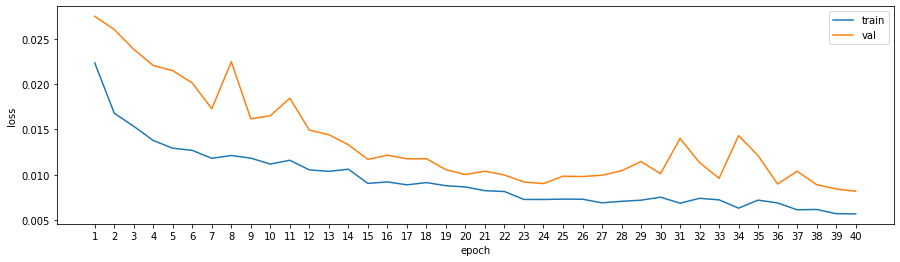

In [ ]:
x_range = range(1, max_epochs+1)
plt.plot(x_range, losses['train'], label='train');
plt.plot(x_range, losses['val'], label='val');
plt.legend()
plt.xticks(x_range)
plt.xlabel('epoch')
plt.ylabel('loss')
plt.show();

In [ ]:
# загрузка модели
unet2_model = UNet2()
unet2_model.load_state_dict(torch.load('/content/gdrive/MyDrive/Colab Notebooks/dls advanced/unet2_model.pth', map_location=torch.device(DEVICE)))

with open('/content/gdrive/MyDrive/Colab Notebooks/dls advanced/losses_unet2.json') as json_file:
    losses_unet2 = json.load(json_file)

In [ ]:
print(f'IoU for U-Net 2 with BCE loss')
print('IoU metric on TRAIN: {:.5f}'.format(score_model(unet2_model, iou_pytorch, data_tr)))
print('IoU metric on VAL: {:.5f}'.format(score_model(unet2_model, iou_pytorch, data_val)))
print('IoU metric on TEST: {:.5f}'.format(score_model(unet2_model, iou_pytorch, data_ts)))

IoU for U-Net 2 with BCE loss
IoU metric on TRAIN: 0.80035
IoU metric on VAL: 0.85051
IoU metric on TEST: 0.83312


In [ ]:
pred_unet2_test = predict(unet2_model, data_ts)

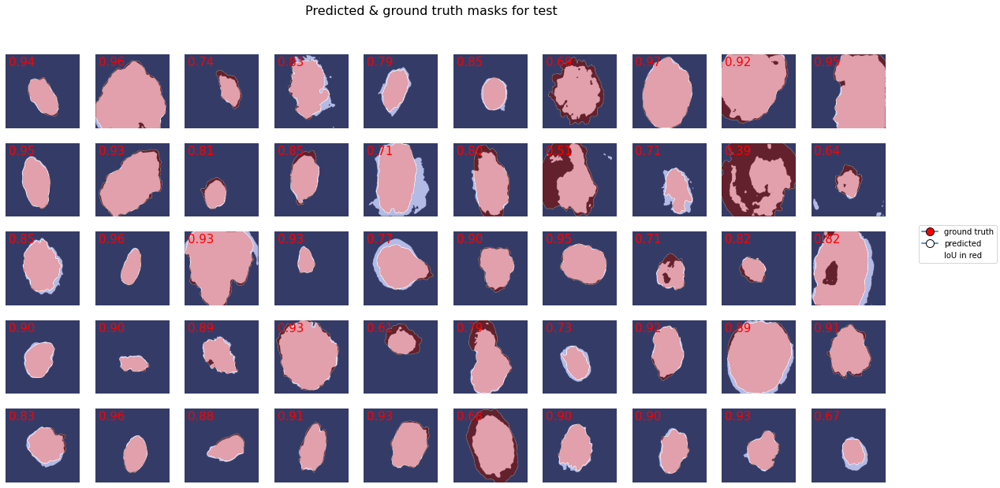

In [ ]:
plot_pred(pred_unet2_test, data_ts.dataset)

#### U-Net 2 focal

In [ ]:
unet2_model_focal = UNet2().to(DEVICE)

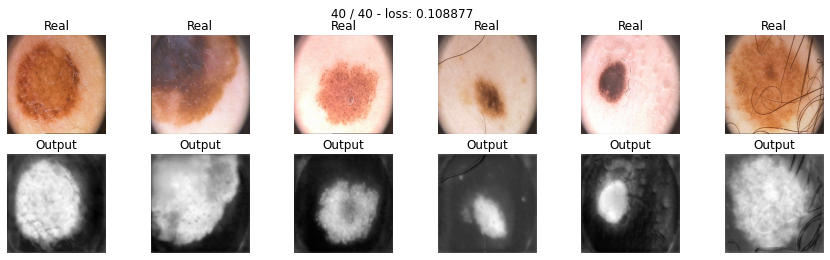

Training complete in 7m 55s


In [ ]:
max_epochs = 40
optimizer = torch.optim.Adam(unet2_model_focal.parameters(), lr=0.001)
unet2_model_focal, losses_unet2_focal = train(unet2_model_focal, optimizer, focal_loss, max_epochs, data_tr, data_val)
torch.save(unet2_model_focal.state_dict(), 'unet2_model_focal.pth')
torch.save(unet2_model_focal.state_dict(), '/content/gdrive/MyDrive/Colab Notebooks/dls advanced/unet2_model_focal.pth')

In [ ]:
import json

with open('/content/gdrive/MyDrive/Colab Notebooks/dls advanced/losses_unet2_focal.json', 'w') as fp:
    json.dump(losses_unet2_focal, fp)

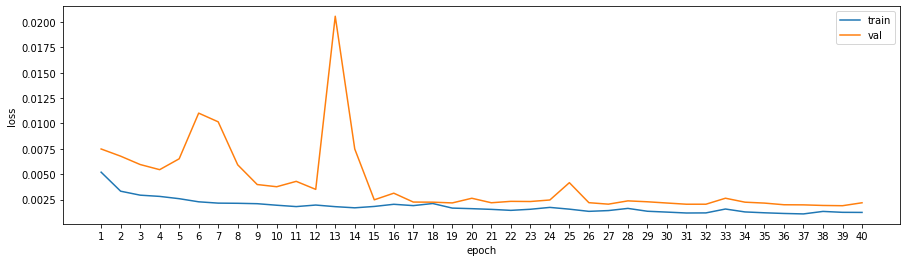

In [ ]:
x_range = range(1, max_epochs+1)
plt.plot(x_range, losses_unet2_focal['train'], label='train');
plt.plot(x_range, losses_unet2_focal['val'], label='val');
plt.legend()
plt.xticks(x_range)
plt.xlabel('epoch')
plt.ylabel('loss')
plt.show();

In [ ]:
# загрузка модели
unet2_model_focal = UNet2()
unet2_model_focal.load_state_dict(torch.load('/content/gdrive/MyDrive/Colab Notebooks/dls advanced/unet2_model_focal.pth', map_location=torch.device(DEVICE)))

with open('/content/gdrive/MyDrive/Colab Notebooks/dls advanced/losses_unet2_focal.json') as json_file:
    losses_unet2_focal = json.load(json_file)

In [ ]:
print(f'IoU for U-Net 2 with focal loss')
print('IoU metric on TRAIN: {:.5f}'.format(score_model(unet2_model_focal, iou_pytorch, data_tr)))
print('IoU metric on VAL: {:.5f}'.format(score_model(unet2_model_focal, iou_pytorch, data_val)))
print('IoU metric on TEST: {:.5f}'.format(score_model(unet2_model_focal, iou_pytorch, data_ts)))

IoU for U-Net 2 with focal loss
IoU metric on TRAIN: 0.82689
IoU metric on VAL: 0.82440
IoU metric on TEST: 0.81696


In [ ]:
pred_unet2_focal_test = predict(unet2_model_focal, data_ts)

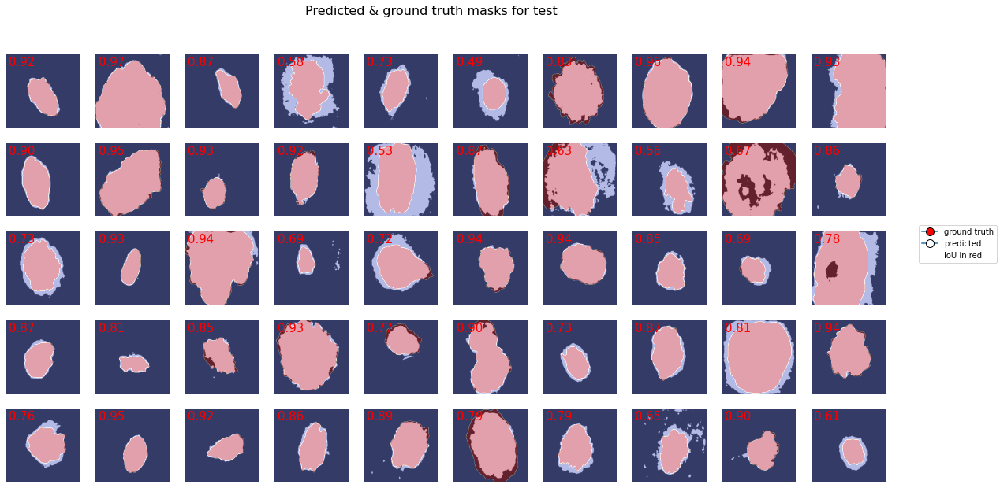

In [ ]:
plot_pred(pred_unet2_focal_test, data_ts.dataset)

#### U-Net 2 dice

In [ ]:
unet2_model_dice = UNet2().to(DEVICE)

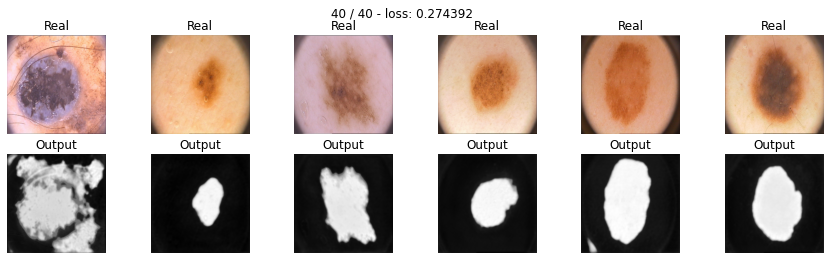

Training complete in 3m 25s


In [ ]:
max_epochs = 40
optimizer = torch.optim.Adam(unet2_model_dice.parameters(), lr=0.001)
unet2_model_dice, losses_unet2_dice = train(unet2_model_dice, optimizer, dice_loss, max_epochs, data_tr, data_val)
torch.save(unet2_model_dice.state_dict(), 'unet2_model_dice_2.pth')
torch.save(unet2_model_dice.state_dict(), '/content/gdrive/MyDrive/Colab Notebooks/dls advanced/unet2_model_dice_2.pth')

In [ ]:
import json

with open('/content/gdrive/MyDrive/Colab Notebooks/dls advanced/losses_unet2_dice_2.json', 'w') as fp:
    json.dump(losses_unet2_dice, fp)

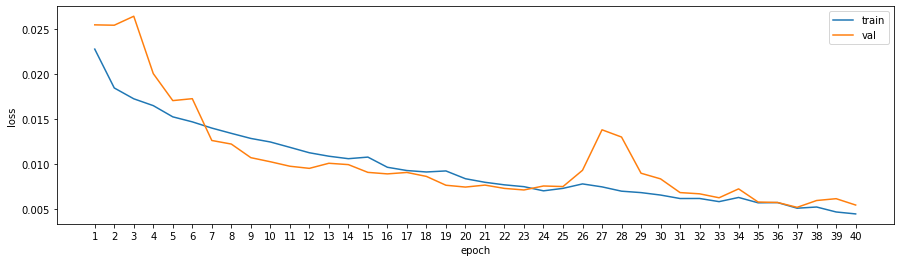

In [ ]:
x_range = range(1, max_epochs+1)
plt.plot(x_range, losses_unet2_dice['train'], label='train');
plt.plot(x_range, losses_unet2_dice['val'], label='val');
plt.legend()
plt.xticks(x_range)
plt.xlabel('epoch')
plt.ylabel('loss')
plt.show();

In [ ]:
# загрузка модели
unet2_model_dice = UNet2()
unet2_model_dice.load_state_dict(torch.load('/content/gdrive/MyDrive/Colab Notebooks/dls advanced/unet2_model_dice_2.pth', map_location=torch.device(DEVICE)))

with open('/content/gdrive/MyDrive/Colab Notebooks/dls advanced/losses_unet2_dice_2.json') as json_file:
    losses_unet2_dice = json.load(json_file)

In [ ]:
print(f'IoU for U-Net 2 with dice loss')
print('IoU metric on TRAIN: {:.5f}'.format(score_model(unet2_model_dice, iou_pytorch, data_tr)))
print('IoU metric on VAL: {:.5f}'.format(score_model(unet2_model_dice, iou_pytorch, data_val)))
print('IoU metric on TEST: {:.5f}'.format(score_model(unet2_model_dice, iou_pytorch, data_ts)))

IoU for U-Net 2 with dice loss
IoU metric on TRAIN: 0.83292
IoU metric on VAL: 0.87107
IoU metric on TEST: 0.84845


In [ ]:
pred_unet2_dice_test = predict(unet2_model_dice, data_ts)

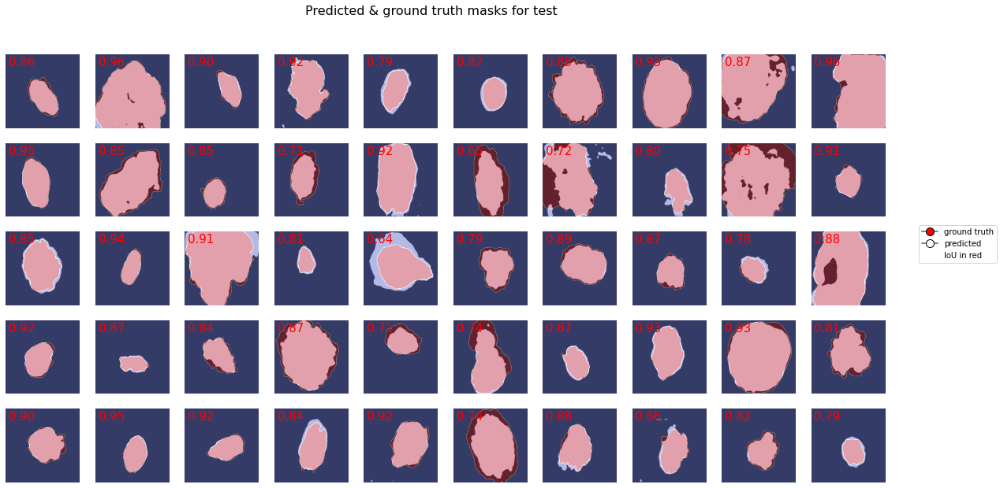

In [ ]:
plot_pred(pred_unet2_dice_test, data_ts.dataset)

#### U-Net 2 hausdorff

In [ ]:
unet2_hd = UNet2().to(DEVICE)
# model

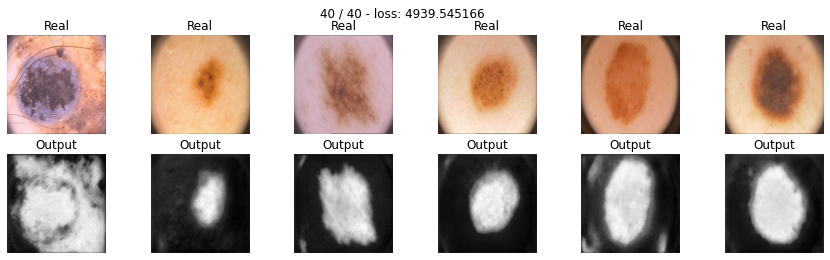

Training complete in 5m 16s


In [ ]:
max_epochs = 40
optim = torch.optim.Adam(unet2_hd.parameters(), lr=0.001)
unet2_hd, losses_unet2_hd = train(unet2_hd, optim, hd_loss, max_epochs, data_tr, data_val)
torch.save(unet2_hd.state_dict(), 'unet2_hd_2.pth')
torch.save(unet2_hd.state_dict(), '/content/gdrive/MyDrive/Colab Notebooks/dls advanced/unet2_hd_2.pth')

In [ ]:
import json

with open('/content/gdrive/MyDrive/Colab Notebooks/dls advanced/losses_unet2_hd_2.json', 'w') as fp:
    json.dump(losses_unet2_hd, fp)

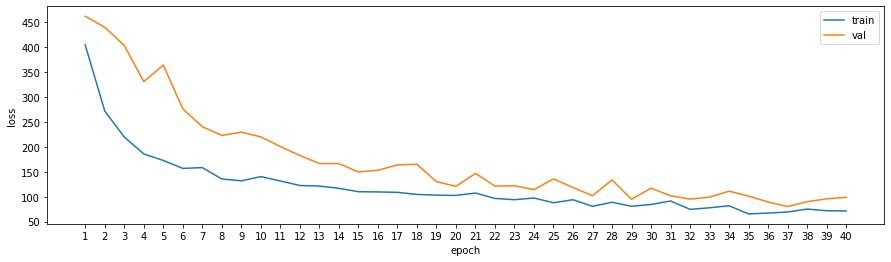

In [ ]:
x_range = range(1, max_epochs+1)
plt.plot(x_range, losses_unet2_hd['train'], label='train');
plt.plot(x_range, losses_unet2_hd['val'], label='val');
plt.legend()
plt.xticks(x_range)
plt.xlabel('epoch')
plt.ylabel('loss')
plt.show();

In [ ]:
# загрузка модели
unet2_hd = UNet2()
unet2_hd.load_state_dict(torch.load('/content/gdrive/MyDrive/Colab Notebooks/dls advanced/unet2_hd_2.pth', map_location=torch.device(DEVICE)))

with open('/content/gdrive/MyDrive/Colab Notebooks/dls advanced/losses_unet2_hd_2.json') as json_file:
    losses_unet2_hd = json.load(json_file)

In [ ]:
print(f'IoU for U-Net 2 with hausdorff loss')
print('IoU metric on TRAIN: {:.5f}'.format(score_model(unet2_hd, iou_pytorch, data_tr)))
print('IoU metric on VAL: {:.5f}'.format(score_model(unet2_hd, iou_pytorch, data_val)))
print('IoU metric on TEST: {:.5f}'.format(score_model(unet2_hd, iou_pytorch, data_ts)))

IoU for U-Net 2 with hausdorff loss
IoU metric on TRAIN: 0.77830
IoU metric on VAL: 0.79057
IoU metric on TEST: 0.72562


In [ ]:
pred_unet2_hd_test = predict(unet2_hd, data_ts)

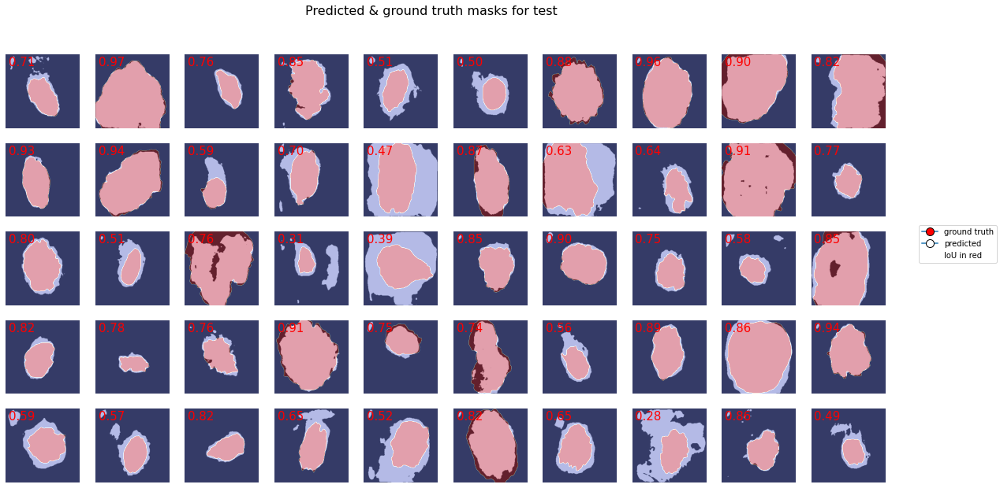

In [ ]:
plot_pred(pred_unet2_hd_test, data_ts.dataset)

#### U-Net 2 focal + dice

In [ ]:
unet2_focal_dice = UNet2().to(DEVICE)
# model

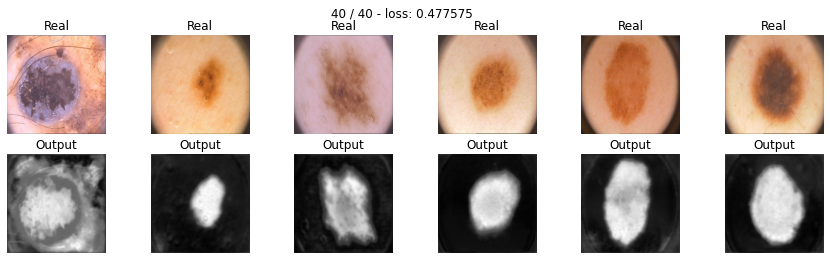

Training complete in 3m 25s


In [ ]:
max_epochs = 40
optim = torch.optim.Adam(unet2_focal_dice.parameters(), lr=0.001)
unet2_focal_dice, losses_unet2_focal_dice = train(unet2_focal_dice, optim, focal_dice_loss, max_epochs, data_tr, data_val)
torch.save(unet2_focal_dice.state_dict(), 'unet2_focal_dice.pth')
torch.save(unet2_focal_dice.state_dict(), '/content/gdrive/MyDrive/Colab Notebooks/dls advanced/unet2_focal_dice.pth')

In [ ]:
import json

with open('/content/gdrive/MyDrive/Colab Notebooks/dls advanced/losses_unet2_focal_dice.json', 'w') as fp:
    json.dump(losses_unet2_focal_dice, fp)

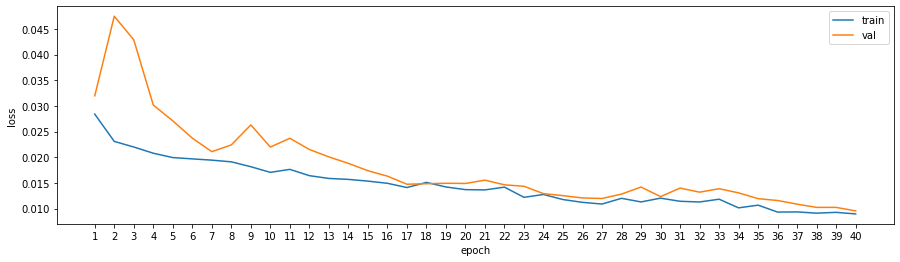

In [ ]:
x_range = range(1, max_epochs+1)
plt.plot(x_range, losses_unet2_focal_dice['train'], label='train');
plt.plot(x_range, losses_unet2_focal_dice['val'], label='val');
plt.legend()
plt.xticks(x_range)
plt.xlabel('epoch')
plt.ylabel('loss')
plt.show();

In [ ]:
# загрузка модели
unet2_focal_dice = UNet2()
unet2_focal_dice.load_state_dict(torch.load('/content/gdrive/MyDrive/Colab Notebooks/dls advanced/unet2_focal_dice.pth', map_location=torch.device(DEVICE)))

with open('/content/gdrive/MyDrive/Colab Notebooks/dls advanced/losses_unet2_focal_dice.json') as json_file:
    losses_unet2_focal_dice = json.load(json_file)

In [ ]:
print(f'IoU for U-Net 2 with focal + dice loss')
print('IoU metric on TRAIN: {:.5f}'.format(score_model(unet2_focal_dice, iou_pytorch, data_tr)))
print('IoU metric on VAL: {:.5f}'.format(score_model(unet2_focal_dice, iou_pytorch, data_val)))
print('IoU metric on TEST: {:.5f}'.format(score_model(unet2_focal_dice, iou_pytorch, data_ts)))

IoU for U-Net 2 with focal + dice loss
IoU metric on TRAIN: 0.85357
IoU metric on VAL: 0.86703
IoU metric on TEST: 0.84757


In [ ]:
pred_unet2_focal_dice_test = predict(unet2_focal_dice, data_ts)

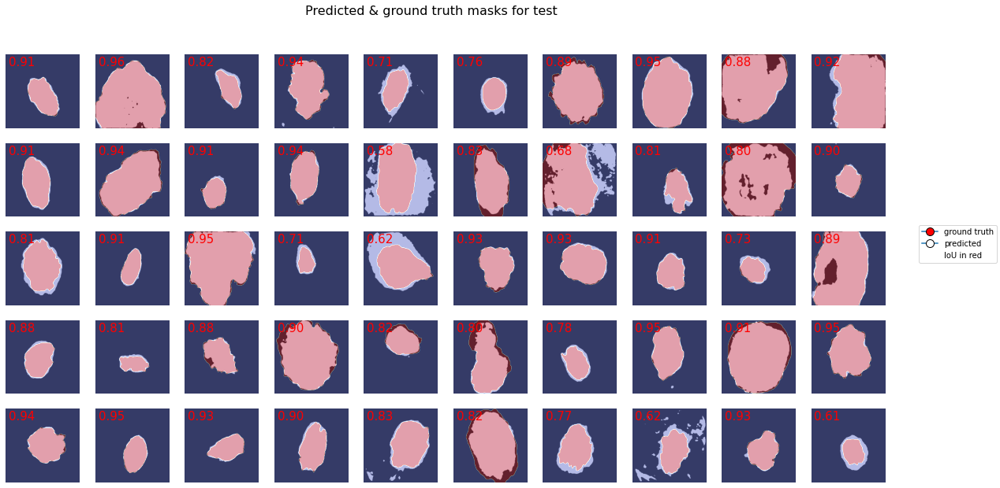

In [ ]:
plot_pred(pred_unet2_focal_dice_test, data_ts.dataset)

#### U-Net 2 focal + dice + hausdorff

In [ ]:
unet2_focal_dice_hd = UNet2().to(DEVICE)
# model

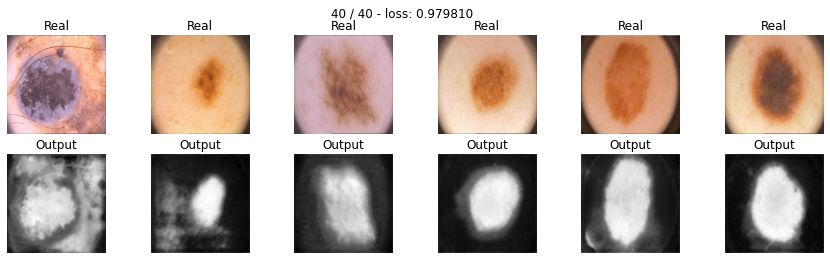

Training complete in 4m 56s


In [ ]:
max_epochs = 40
optim = torch.optim.Adam(unet2_focal_dice_hd.parameters(), lr=0.001)
unet2_focal_dice_hd, losses_unet2_focal_dice_hd = train(unet2_focal_dice_hd, optim, focal_dice_hd_loss, max_epochs, data_tr, data_val)
torch.save(unet2_focal_dice_hd.state_dict(), 'unet2_focal_dice_hd.pth')
torch.save(unet2_focal_dice_hd.state_dict(), '/content/gdrive/MyDrive/Colab Notebooks/dls advanced/unet2_focal_dice_hd.pth')

In [ ]:
import json

with open('/content/gdrive/MyDrive/Colab Notebooks/dls advanced/losses_unet2_focal_dice_hd.json', 'w') as fp:
    json.dump(losses_unet2_focal_dice_hd, fp)

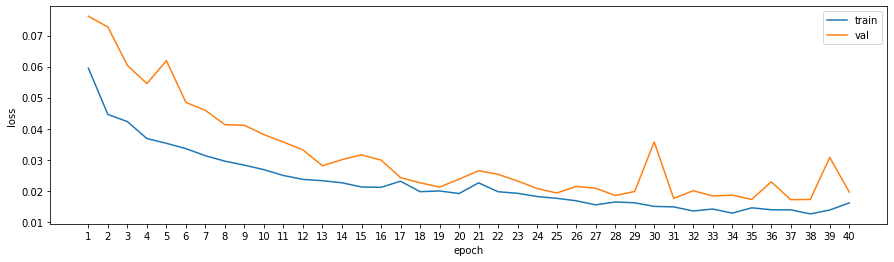

In [ ]:
x_range = range(1, max_epochs+1)
plt.plot(x_range, losses_unet2_focal_dice_hd['train'], label='train');
plt.plot(x_range, losses_unet2_focal_dice_hd['val'], label='val');
plt.legend()
plt.xticks(x_range)
plt.xlabel('epoch')
plt.ylabel('loss')
plt.show();

In [ ]:
# загрузка модели
unet2_focal_dice_hd = UNet2()
unet2_focal_dice_hd.load_state_dict(torch.load('/content/gdrive/MyDrive/Colab Notebooks/dls advanced/unet2_focal_dice_hd.pth', map_location=torch.device(DEVICE)))

with open('/content/gdrive/MyDrive/Colab Notebooks/dls advanced/losses_unet2_focal_dice_hd.json') as json_file:
    losses_unet2_focal_dice_hd = json.load(json_file)

In [ ]:
print(f'IoU for U-Net 2 with focal + dice + hausdorff loss')
print('IoU metric on TRAIN: {:.5f}'.format(score_model(unet2_focal_dice_hd, iou_pytorch, data_tr)))
print('IoU metric on VAL: {:.5f}'.format(score_model(unet2_focal_dice_hd, iou_pytorch, data_val)))
print('IoU metric on TEST: {:.5f}'.format(score_model(unet2_focal_dice_hd, iou_pytorch, data_ts)))

IoU for U-Net 2 with focal + dice + hausdorff loss
IoU metric on TRAIN: 0.78658
IoU metric on VAL: 0.83964
IoU metric on TEST: 0.77315


In [ ]:
pred_unet2_focal_dice_hd_test = predict(unet2_focal_dice_hd, data_ts)

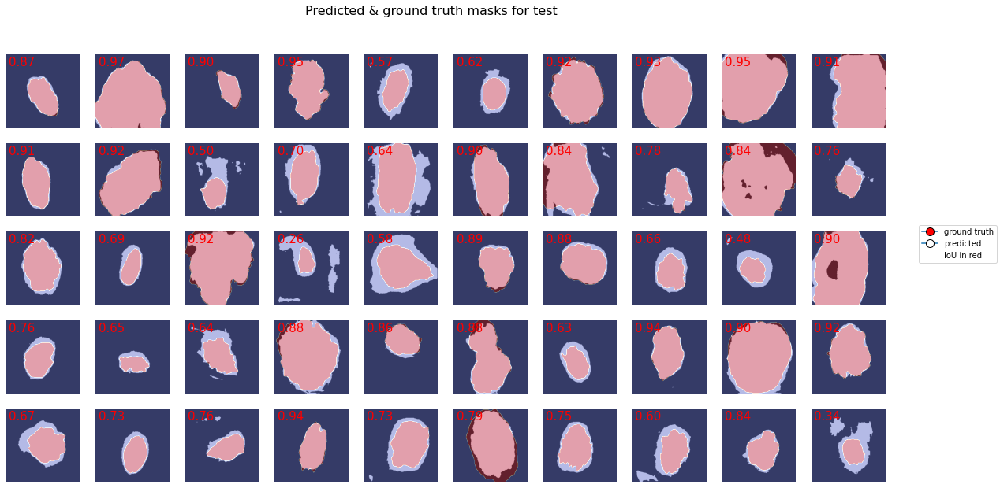

In [ ]:
plot_pred(pred_unet2_focal_dice_hd_test, data_ts.dataset)

#### U-Net 2 focal + hausdorff

In [ ]:
unet2_focal_hd = UNet2().to(DEVICE)
# model

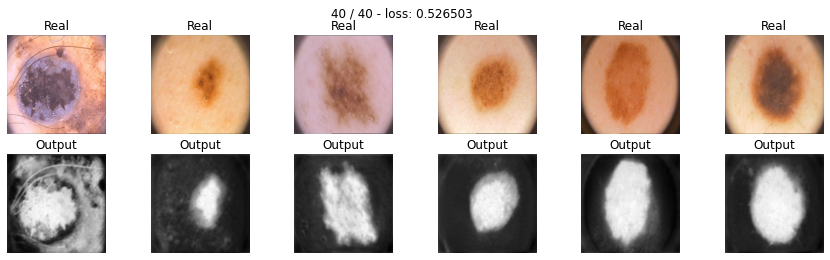

Training complete in 4m 57s


In [ ]:
max_epochs = 40
optim = torch.optim.Adam(unet2_focal_hd.parameters(), lr=0.001)
unet2_focal_hd, losses_unet2_focal_hd = train(unet2_focal_hd, optim, focal_hd_loss, max_epochs, data_tr, data_val)
torch.save(unet2_focal_hd.state_dict(), 'unet2_focal_hd.pth')
torch.save(unet2_focal_hd.state_dict(), '/content/gdrive/MyDrive/Colab Notebooks/dls advanced/unet2_focal_hd.pth')

In [ ]:
import json

with open('/content/gdrive/MyDrive/Colab Notebooks/dls advanced/losses_unet2_focal_hd.json', 'w') as fp:
    json.dump(losses_unet2_focal_hd, fp)

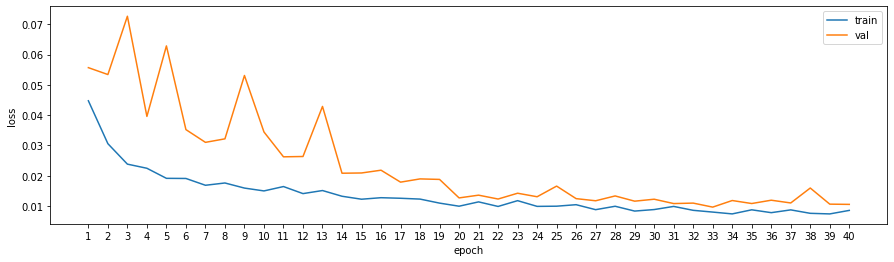

In [ ]:
x_range = range(1, max_epochs+1)
plt.plot(x_range, losses_unet2_focal_hd['train'], label='train');
plt.plot(x_range, losses_unet2_focal_hd['val'], label='val');
plt.legend()
plt.xticks(x_range)
plt.xlabel('epoch')
plt.ylabel('loss')
plt.show();

In [ ]:
# загрузка модели
unet2_focal_hd = UNet2()
unet2_focal_hd.load_state_dict(torch.load('/content/gdrive/MyDrive/Colab Notebooks/dls advanced/unet2_focal_hd.pth', map_location=torch.device(DEVICE)))

with open('/content/gdrive/MyDrive/Colab Notebooks/dls advanced/losses_unet2_focal_hd.json') as json_file:
    losses_unet2_focal_hd = json.load(json_file)

In [ ]:
print(f'IoU for U-Net 2 with focal + hausdorff loss')
print('IoU metric on TRAIN: {:.5f}'.format(score_model(unet2_focal_hd, iou_pytorch, data_tr)))
print('IoU metric on VAL: {:.5f}'.format(score_model(unet2_focal_hd, iou_pytorch, data_val)))
print('IoU metric on TEST: {:.5f}'.format(score_model(unet2_focal_hd, iou_pytorch, data_ts)))

IoU for U-Net 2 with focal + hausdorff loss
IoU metric on TRAIN: 0.84533
IoU metric on VAL: 0.89108
IoU metric on TEST: 0.85721


In [ ]:
pred_unet2_focal_hd_test = predict(unet2_focal_hd, data_ts)

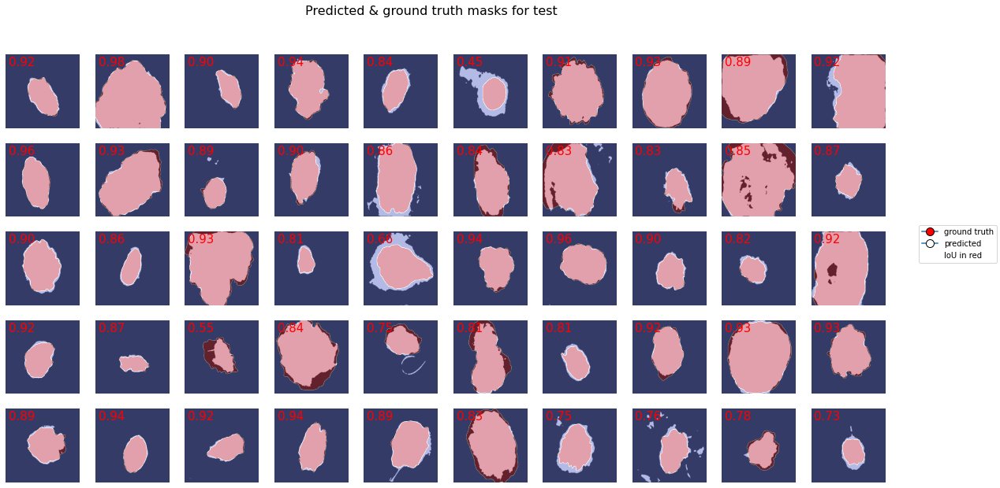

In [ ]:
plot_pred(pred_unet2_focal_hd_test, data_ts.dataset)

Сделайте вывод, какая из моделей лучше

# Отчет (6 баллов): 
Ниже предлагается написать отчет о проделанно работе и построить графики для лоссов, метрик на валидации и тесте. 
Если вы пропустили какую-то часть в задании выше, то вы все равно можете получить основную часть баллов в отчете, если правильно зададите проверяемые вами гипотезы.


Аккуратно сравните модели между собой и соберите наилучшую архитектуру. Проверьте каждую модель с различными лоссами. Мы не ограничиваем вас в формате отчета, но проверяющий должен отчетливо понять для чего построен каждый график, какие выводы вы из него сделали и какой общий вывод можно сделать на основании данных моделей. Если вы захотите добавить что-то еще, чтобы увеличить шансы получения максимального балла, то добавляйте отдельное сравнение.

Дополнительные комментарии: 

Пусть у вас есть N обученных моделей.
- Является ли отчетом N графиков с 1 линей? Да, но очень низкокачественным, потому что проверяющий не сможет сам сравнить их.

- Является ли отчетом 1 график с N линиями? Да, но скорее всего таким образом вы отразили лишь один эффект. Этого мало, чтобы сделать досточно суждений по поводу вашей работа.

- Я проверял метрики на трейне, и привел в результате таблицу с N числами, что не так? ключейвой момент тут, что вы измеряли на трейне ваши метрики, уверены ли вы, что заивисмости останутся такими же на отложенной выборке?

- Я сделал отчет содержащий график лоссов и метрик, и у меня нет ошибок в основной части, но за отчет не стоит максимум, почему? Естестественно максимум баллов за отчет можно получить не за 2 графика (даже при условии их полной правильности). Проверяющий хочет видеть больше сравнений моделей, чем метрики и лоссы (особенно, если они на трейне).

Советы: попробуйте правильно поставить вопрос на который вы себе отвечаете и продемонстрировать таблицу/график, помогающий проверяющему увидеть ответ на этот вопрос. Пример: Ваня хочет узнать, с каким из 4-х лоссов модель (например, U-Net) имеет наилучшее качество. Что нужно сделать Ване? Обучить 4 одинаковых модели с разными лосс функциями. И измерить итогововое качество. Продемонстрировать результаты своих измерений и итоговый вывод. (warning: конечно же, это не идеально ответит на наш вопрос, так как мы не учитываем в экспериментах возможные различные типы ошибок, но для первого приближения этого вполне достаточно).

Примерное время на подготовку отчета 1 час, он содержит сравнеение метрик, график лоссов, выбор лучших моделей из нескольких кластеров и выбор просто лучшей модели, небольшой вывод по всему дз, возможно сравнение результирующих сегментаций, времени или числа параметров модели, проявляйте креативность.

In [ ]:
def count_parameters(model):
    return sum(p.numel() for p in model.parameters() if p.requires_grad)

In [ ]:
count_parameters(model), count_parameters(unet_model), count_parameters(unet2_model_focal)

(29443587, 7765985, 8114625)

|model|number of papameters|time of training (GPU)|
|--|--|--|
|SegNet    |29.443.587| ~7-8 min|
|U-Net     |7.765.985| ~3-5 min|
|U-Net 2   |8.114.625| ~3-5 min|


In [ ]:
models_result = {'segnet_bce': 
            (losses_segnet_2,
            [0.71957, 0.74279, 0.70032]),
          'segnet_dice':
            (losses_dice,
             [0.77003, 0.80848, 0.74726]),
          'segnet_focal':
            (losses_focal,
             [0.77462, 0.79111, 0.80040]),
          'segnet_hausdorff':
            (losses_hd,
             [0.67973, 0.68541, 0.67370]),
          'segnet_focal_dice':
            (losses_focal_dice,
             [0.79849, 0.82839, 0.78681]),
          'segnet_focal_hausdorff':
            (losses_focal_hd,
            [0.70780, 0.72216, 0.70983]),
          'segnet_focal_dice_hausdorff':
            (losses_focal_dice_hd,
             [0.75718, 0.75699, 0.77256]),
          'unet_bce':
            (losses_unet,
             [0.82128, 0.86517, 0.82920]),
          'unet_dice':
            (losses_unet_dice,
             [0.82096, 0.85644, 0.81548]),
          'unet_focal':
            (losses_unet_focal,
             [0.82888, 0.86943, 0.82183]),
          'unet_hausdorff':
            (losses_unet_hd,
             [0.78279, 0.84749, 0.80576]),
          'unet_focal_dice':
            (losses_unet_focal_dice,
             [0.78888, 0.81412, 0.78656]),
          'unet_focal_hausdorff':
            (losses_unet_focal_hd,
             [0.73390, 0.76119, 0.71405]),
          'unet_focal_dice_hausdorff':
            (losses_unet_focal_dice_hd,
             [0.81208, 0.84104, 0.80819]),
          'unet2_bce':
            (losses_unet2,
             [0.80035, 0.85051, 0.83312]),
          'unet2_dice':
            (losses_unet2_dice,
             [0.83292, 0.87107, 0.84845]),
          'unet2_focal':
            (losses_unet2_focal,
             [0.82689, 0.82440, 0.81696]),
          'unet2_hausdorff':
            (losses_unet2_hd,
             [0.77830, 0.79057, 0.72562]),
          'unet2_focal_dice':
            (losses_unet2_focal_dice,
             [0.85357, 0.86703, 0.84757]),
          'unet2_focal_hausdorff':
            (losses_unet2_focal_hd,
             [0.84533, 0.89108, 0.85721]),
          'unet2_focal_dice_hausdorff':
            (losses_unet2_focal_dice_hd,
             [0.78658, 0.83964, 0.77315])
          }

In [ ]:
for i, key in enumerate(models_result.keys()):
    print(i, key)

0 segnet_bce
1 segnet_dice
2 segnet_focal
3 segnet_hausdorff
4 segnet_focal_dice
5 segnet_focal_hausdorff
6 segnet_focal_dice_hausdorff
7 unet_bce
8 unet_dice
9 unet_focal
10 unet_hausdorff
11 unet_focal_dice
12 unet_focal_hausdorff
13 unet_focal_dice_hausdorff
14 unet2_bce
15 unet2_dice
16 unet2_focal
17 unet2_hausdorff
18 unet2_focal_dice
19 unet2_focal_hausdorff
20 unet2_focal_dice_hausdorff


In [ ]:
from matplotlib.cm import get_cmap
colors = get_cmap("tab20").colors  # type: list

max_epochs = 40
x_range = range(1, max_epochs+1)

In [ ]:
all_keys = list(models_result.keys())

# ключи по моделям
models = ['SegNet', 'U-Net', 'U-Net 2']

segnets = all_keys[:7]
unets = all_keys[7:14]
unets2 = all_keys[14:]

In [ ]:
# кючи по лоссам
losses = ['BCE', 'dice', 'focal', 'hausdorff', 'focal + dice', 
          'focal + hausdorff', 'focal + dice + hausdorff']

bces = [all_keys[i] for i in range(0, 21, 7)]
dices = [all_keys[i] for i in range(1, 21, 7)]
focals = [all_keys[i] for i in range(2, 21, 7)]
hds = [all_keys[i] for i in range(3, 21, 7)]
focal_dices = [all_keys[i] for i in range(4, 21, 7)]
focal_hds = [all_keys[i] for i in range(5, 21, 7)]
focal_dice_hds = [all_keys[i] for i in range(6, 21, 7)]

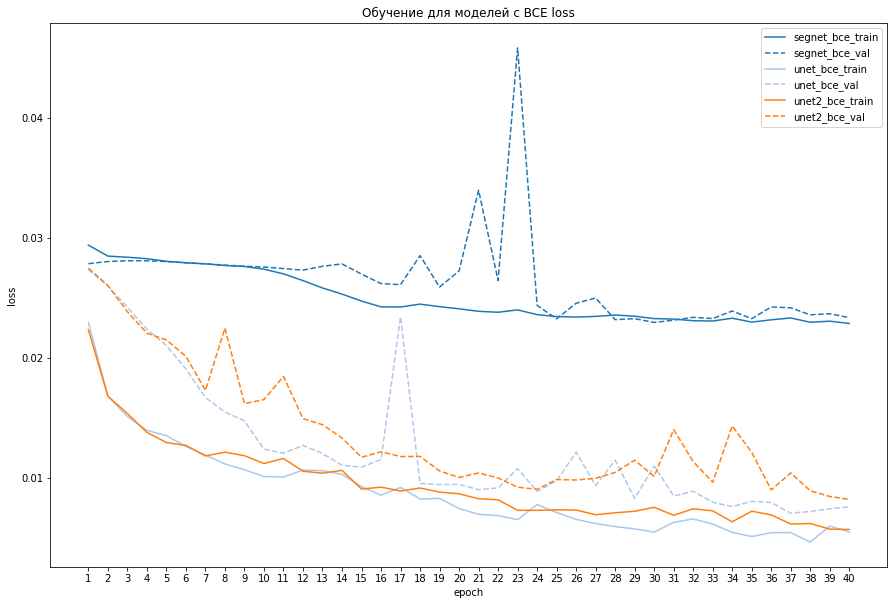

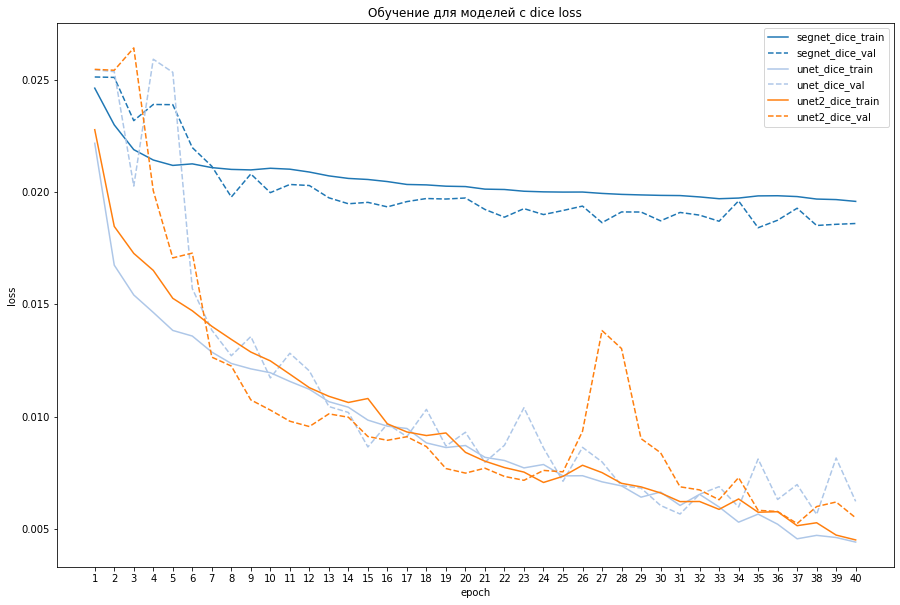

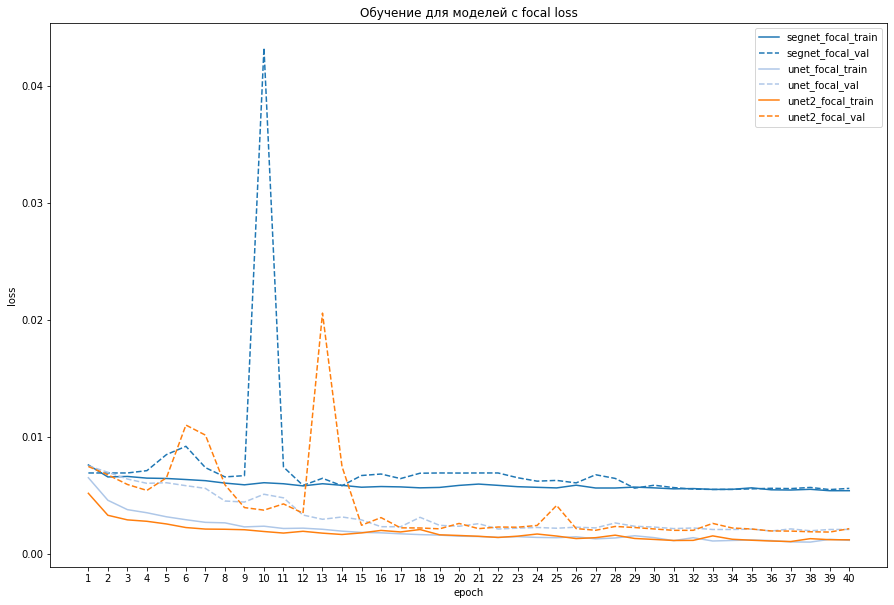

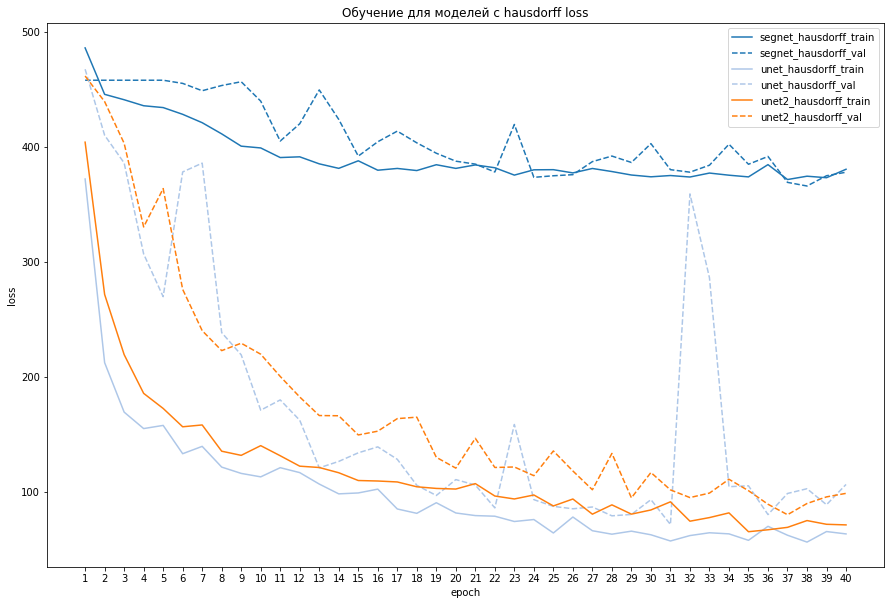

In [ ]:
for i in range(0, 4):
    start = i
    key = all_keys[i]
    c = 0
    plt.figure(figsize=(15, 10));
    plt.plot(x_range, models_result[key][0]['train'], label=key+'_train', color=colors[c]);
    plt.plot(x_range, models_result[key][0]['val'], label=key+'_val', linestyle='dashed', color=colors[c]);
    i += 7
    key = all_keys[i]
    c += 1
    plt.plot(x_range, models_result[key][0]['train'], label=key+'_train', color=colors[c]);
    plt.plot(x_range, models_result[key][0]['val'], label=key+'_val', linestyle='dashed', color=colors[c]);
    i += 7
    key = all_keys[i]
    c += 1
    plt.plot(x_range, models_result[key][0]['train'], label=key+'_train', color=colors[c]);
    plt.plot(x_range, models_result[key][0]['val'], label=key+'_val', linestyle='dashed', color=colors[c]);

    plt.legend()
    plt.xticks(x_range)
    plt.xlabel('epoch')
    plt.ylabel('loss')
    plt.title(f"Обучение для моделей с {losses[start]} loss")
    plt.show();

Видно, что к концу оюучения лоссы U-Net моделей меньше, чем SegNet.

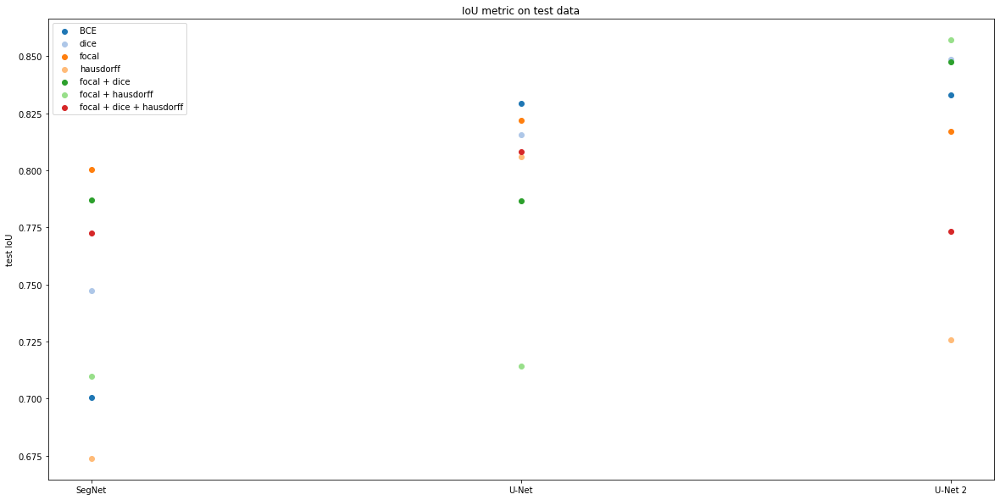

In [ ]:
plt.figure(figsize=(20, 10))

for i in range(0, 7):
    key = all_keys[i]
    plt.scatter([0], models_result[key][1][2], color=colors[i], label=losses[i])
for i in range(7, 14):
    key = all_keys[i]
    plt.scatter([1], models_result[key][1][2], color=colors[i-7])
for i in range(14, 21):
    key = all_keys[i]
    plt.scatter([2], models_result[key][1][2], color=colors[i-14])

plt.ylabel('test IoU');
plt.xticks([0, 1, 2], labels=models);
plt.legend();
plt.title('IoU metric on test data');
plt.show();

# Вывод

- Distrubution-based loss: BCE, Focal
- Region-based loss: Dice
- Boundary-based loss: Haussdorf
<img src='https://miro.medium.com/max/1400/1*dWBAei84Ld3HtZPx257tHQ.png' alt=';osses-scheme'>


У U-Net 2 в целом наилучшие результаты, у SegNet - наихудшие.

На рызных моделях разные лоссы дают разный результат.

Наилучшие результаты по моделям:
- SegNet: focal
- U-Net: BCE
- U-Net 2: focal + huasdorff

Также попробовала соединить разные лоссы разных типов. Это не дало прироста в качестве (в основном). Возможно это связано с тем, что лоссы нужно перевзвешивать при суммировании.

Hausdorff loss дает не очень хороши результаты, и в целом не помогает в смешанных лоссах. (возможно это связано выбором гиперпараметра в самом лосе, либо с весами в смешанных лоссах)

- SegNet: смешанные лоссы снижают результат по сравнению с "чистыми" лосами
- U-Net: аналогично, смешанные снижают результат
- U-Net 2: лучший результат с лоссом focal + huasdorff

Также заметно, что UNet обучаются и делают предсказания заметно быстрее, чем SegNet. И у них меньше разница на train val test. Значит они меньше переобучаются. Это согласуется со статьей по *Unet*.

Также можно посмотреть на некоторых картинках, что предсказывает U-Net 2, обученная с разными лоссами

In [ ]:
interesting_images = [data_ts.dataset[14], data_ts.dataset[17], data_val.dataset[30], data_val.dataset[38]]

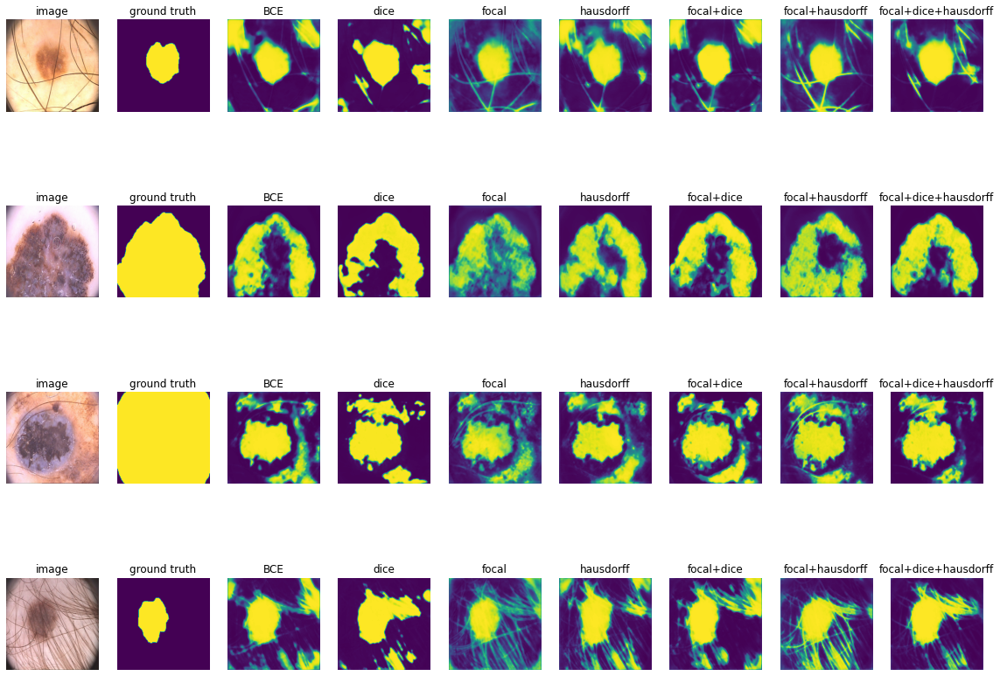

In [ ]:
plt.figure(figsize=(20,15))
n_rows = len(interesting_images)
n_cols = 9
for i, image in enumerate(interesting_images):
    plt.subplot(n_rows, n_cols, i*n_cols + 1)
    plt.imshow(np.moveaxis(image[0], 0, 2));
    plt.axis('off');
    plt.title('image');
    plt.subplot(n_rows, n_cols, i*n_cols + 2)
    plt.imshow(image[1][0]);
    plt.axis('off');
    plt.title('ground truth')
    plt.subplot(n_rows, n_cols, i*n_cols + 3)
    pred = nn.Sigmoid()(unet2_model(torch.tensor(image[0]).unsqueeze(0)))
    plt.imshow(pred[0][0].detach().numpy());
    plt.axis('off');
    plt.title('BCE');
    plt.subplot(n_rows, n_cols, i*n_cols + 4)
    pred = nn.Sigmoid()(unet2_model_dice(torch.tensor(image[0]).unsqueeze(0)))
    plt.imshow(pred[0][0].detach().numpy());
    plt.axis('off');
    plt.title('dice');
    plt.subplot(n_rows, n_cols, i*n_cols + 5)
    pred = nn.Sigmoid()(unet2_model_focal(torch.tensor(image[0]).unsqueeze(0)))
    plt.imshow(pred[0][0].detach().numpy());
    plt.axis('off');
    plt.title('focal');
    plt.subplot(n_rows, n_cols, i*n_cols + 6)
    pred = nn.Sigmoid()(unet2_hd(torch.tensor(image[0]).unsqueeze(0)))
    plt.imshow(pred[0][0].detach().numpy());
    plt.axis('off');
    plt.title('hausdorff');
    plt.subplot(n_rows, n_cols, i*n_cols + 7)
    pred = nn.Sigmoid()(unet2_focal_dice(torch.tensor(image[0]).unsqueeze(0)))
    plt.imshow(pred[0][0].detach().numpy());
    plt.axis('off');
    plt.title('focal+dice');
    plt.subplot(n_rows, n_cols, i*n_cols + 8)
    pred = nn.Sigmoid()(unet2_focal_hd(torch.tensor(image[0]).unsqueeze(0)))
    plt.imshow(pred[0][0].detach().numpy());
    plt.axis('off');
    plt.title('focal+hausdorff');
    plt.subplot(n_rows, n_cols, i*n_cols + 9)
    pred = nn.Sigmoid()(unet2_focal_dice_hd(torch.tensor(image[0]).unsqueeze(0)))
    plt.imshow(pred[0][0].detach().numpy());
    plt.axis('off');
    plt.title('focal+dice+hausdorff');
plt.show()